In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
# Install torch_geometric (PyG) correctly for Kaggle
import os

print("🚀 Installing PyTorch Geometric for Kaggle...")

# Torch geometric core packages
os.system("pip install torch_scatter torch_sparse torch_cluster torch_spline_conv -f https://data.pyg.org/whl/torch-2.1.0+cu121.html")
os.system("pip install torch_geometric")

print("✅ PyTorch Geometric installation complete!")


🚀 Installing PyTorch Geometric for Kaggle...
Looking in links: https://data.pyg.org/whl/torch-2.1.0+cu121.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 38.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 99.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 101.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 936.0/936.0 kB 50.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 25.1 MB/s eta 0:00:00
✅ PyTorch Geometric installation complete!


In [2]:


import os
import cv2
import random
import numpy as np
import pandas as pd
from glob import glob
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler

# Graph
from torch_geometric.nn import GCNConv

# Augmentation
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Vision backbone
import timm

# Metrics & splits
from sklearn.model_selection import StratifiedKFold, StratifiedShuffleSplit
from sklearn.metrics import (
    accuracy_score,
    cohen_kappa_score,
    classification_report,
    confusion_matrix
)

import matplotlib.pyplot as plt
import seaborn as sns

# ----------------- CONFIG -----------------
class CFG:
    IMG_SIZE = 224
    BATCH_SIZE = 16
    EPOCHS = 25
    LR = 1e-4
    WEIGHT_DECAY = 1e-4
    NUM_CLASSES = 5
    DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    SEED = 42
    N_FOLDS = 3          # on train_val only
    EARLY_STOP_PATIENCE = 5
    TEST_SIZE = 0.15     # hold-out test (same as before ~949 images)

print("Using device:", CFG.DEVICE)

def seed_everything(seed=42):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

seed_everything(CFG.SEED)
print("✅ Seeded and ready.")


/usr/local/lib/python3.11/dist-packages/torch_geometric/__init__.py:4: UserWarning: An issue occurred while importing 'torch-scatter'. Disabling its usage. Stacktrace: /usr/local/lib/python3.11/dist-packages/torch_scatter/_version_cuda.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev
  import torch_geometric.typing
/usr/local/lib/python3.11/dist-packages/torch_geometric/__init__.py:4: UserWarning: An issue occurred while importing 'torch-cluster'. Disabling its usage. Stacktrace: /usr/local/lib/python3.11/dist-packages/torch_cluster/_version_cuda.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev
  import torch_geometric.typing
/usr/local/lib/python3.11/dist-packages/torch_geometric/__init__.py:4: UserWarning: An issue occurred while importing 'torch-spline-conv'. Disabling its usage. Stacktrace: /usr/local/lib/python3.11/dist-packages/torch_spline_conv/_version_cuda.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev
  import torch_geometric.typing
/usr/local/lib/python3.11/dis

Using device: cuda
✅ Seeded and ready.


In [3]:
# Cell 2: Load all images into df

data_dir = "/kaggle/input/ultrasound-dataset/Dataset"

class_map = {"F0": 0, "F1": 1, "F2": 2, "F3": 3, "F4": 4}

image_paths = []
labels = []

for folder, label in class_map.items():
    folder_path = os.path.join(data_dir, folder)
    if not os.path.isdir(folder_path):
        print("⚠️ Missing folder:", folder_path)
        continue

    imgs = []
    imgs += glob(os.path.join(folder_path, "*.png"))
    imgs += glob(os.path.join(folder_path, "*.jpg"))
    imgs += glob(os.path.join(folder_path, "*.jpeg"))

    print(f"{folder}: found {len(imgs)} images")
    for p in imgs:
        image_paths.append(p)
        labels.append(label)

df_all = pd.DataFrame({"image_path": image_paths, "diagnosis": labels})
df_all = df_all.sample(frac=1.0, random_state=CFG.SEED).reset_index(drop=True)

print("Total images:", len(df_all))
print(df_all.head())


F0: found 2114 images
F1: found 861 images
F2: found 793 images
F3: found 857 images
F4: found 1698 images
Total images: 6323
                                          image_path  diagnosis
0  /kaggle/input/ultrasound-dataset/Dataset/F3/S6...          3
1  /kaggle/input/ultrasound-dataset/Dataset/F4/G4...          4
2  /kaggle/input/ultrasound-dataset/Dataset/F0/k1...          0
3  /kaggle/input/ultrasound-dataset/Dataset/F2/w5...          2
4  /kaggle/input/ultrasound-dataset/Dataset/F1/a7...          1


In [4]:
# Cell 3: Stratified train_val / test split (NO LEAKAGE)

sss = StratifiedShuffleSplit(
    n_splits=1,
    test_size=CFG.TEST_SIZE,
    random_state=CFG.SEED
)

for train_val_idx, test_idx in sss.split(df_all, df_all["diagnosis"]):
    train_val_df = df_all.iloc[train_val_idx].reset_index(drop=True)
    test_df      = df_all.iloc[test_idx].reset_index(drop=True)

print("Train+Val:", len(train_val_df))
print("Test     :", len(test_df))

print("\nTest set class distribution:")
print(test_df["diagnosis"].value_counts().sort_index())


Train+Val: 5374
Test     : 949

Test set class distribution:
diagnosis
0    317
1    129
2    119
3    129
4    255
Name: count, dtype: int64


In [5]:
# Cell 4: Preprocessing & Augmentations

def clahe_equalized(img_rgb):
    lab = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l_clahe = clahe.apply(l)
    lab_clahe = cv2.merge((l_clahe, a, b))
    return cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2RGB)

def sharpen(img):
    kernel = np.array([[-1,-1,-1],
                       [-1, 9,-1],
                       [-1,-1,-1]])
    return cv2.filter2D(img, -1, kernel)

def preprocess_for_model(path):
    img = cv2.imread(path)
    if img is None:
        return None
    if len(img.shape) == 2 or img.shape[2] == 1:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    else:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img_denoised = cv2.medianBlur(img_rgb, 3)
    img_clahe = clahe_equalized(img_denoised)
    img_sharp = sharpen(img_clahe)
    return img_sharp

train_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Affine(scale=(0.9, 1.1),
             translate_percent=(0.05, 0.05),
             rotate=(-20, 20), p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.2),
    A.RandomBrightnessContrast(p=0.6),
    A.CoarseDropout(
        num_holes_range=(1, 8),
        hole_height_range=(4, CFG.IMG_SIZE//14),
        hole_width_range=(4, CFG.IMG_SIZE//14),
        p=0.4
    ),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

valid_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

print("✅ Preprocessing & augmentations ready.")


✅ Preprocessing & augmentations ready.


In [6]:
# Cell 5: LiverDataset

class LiverDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img = preprocess_for_model(row.image_path)
        if img is None:
            img = np.zeros((CFG.IMG_SIZE, CFG.IMG_SIZE, 3), dtype=np.uint8)

        if self.transform:
            augmented = self.transform(image=img)
            img_tensor = augmented["image"]
        else:
            img_tensor = torch.from_numpy(img).permute(2, 0, 1).float() / 255.0

        label = torch.tensor(row.diagnosis, dtype=torch.long)
        return img_tensor, label

print("✅ LiverDataset defined.")


✅ LiverDataset defined.


In [7]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import timm

from torch_geometric.nn import MessagePassing
from torch_geometric.utils import remove_self_loops, to_undirected
from torch_geometric.nn import global_mean_pool

# -----------------------------
# 1) kNN graph builder (your version, cleaned)
# -----------------------------
def build_knn_graph(feature_map, k=8):
    """
    feature_map: [C, H, W]
    returns:
      x_nodes: [N, C]
      edge_index: [2, E] (undirected, no self loops)
    """
    C, H, W = feature_map.shape
    N = H * W

    x_nodes = feature_map.view(C, N).permute(1, 0).contiguous()  # [N,C]

    with torch.no_grad():
        dist = torch.cdist(x_nodes, x_nodes)         # [N,N]
        dist.fill_diagonal_(float("inf"))            # no self neighbor
        knn_idx = dist.topk(k=k, largest=False).indices  # [N,k]

    src = torch.arange(N, device=feature_map.device).view(-1, 1).repeat(1, k).reshape(-1)
    dst = knn_idx.reshape(-1)

    edge_index = torch.stack([src, dst], dim=0)
    edge_index, _ = remove_self_loops(edge_index)
    edge_index = to_undirected(edge_index)           # make undirected
    edge_index = edge_index.long()

    return x_nodes, edge_index


# -----------------------------
# 2) SGN layer on edge_index (PyG)
# -----------------------------
class SGNConv(MessagePassing):
    """
    SGN-style conv:
      out = W_self(x) + W_neigh(AGG(neighbor x))
    """
    def __init__(self, in_channels, out_channels, dropout=0.2, aggr="mean"):
        super().__init__(aggr=aggr)  # mean aggregation is common
        self.lin_self  = nn.Linear(in_channels, out_channels, bias=False)
        self.lin_neigh = nn.Linear(in_channels, out_channels, bias=False)
        self.bn = nn.BatchNorm1d(out_channels)
        self.drop = nn.Dropout(dropout)

    def forward(self, x, edge_index):
        # x: [N, C]
        neigh = self.propagate(edge_index, x=x)  # [N,C] aggregated neighbors
        out = self.lin_self(x) + self.lin_neigh(neigh)  # [N,out]
        out = self.bn(out)
        out = F.relu(self.drop(out))
        return out

    def message(self, x_j):
        return x_j


# -----------------------------
# 3) DenseNet + kNN-SGN model
# -----------------------------
class DenseNet_kNNSGN(nn.Module):
    def __init__(self, num_classes=5, k=8):
        super().__init__()
        self.k = k

        self.backbone = timm.create_model(
            "densenet121",
            pretrained=True,
            features_only=True,
            out_indices=[-1]
        )

        # SAFE dummy on same device
        dummy = torch.zeros(1, 3, CFG.IMG_SIZE, CFG.IMG_SIZE)
        dummy = dummy.to(next(self.backbone.parameters()).device)
        with torch.no_grad():
            feat = self.backbone(dummy)[0]
        self.feat_channels = feat.shape[1]
        print("DenseNet feat channels:", self.feat_channels)

        self.sgn1 = SGNConv(self.feat_channels, 512, dropout=0.3)
        self.sgn2 = SGNConv(512, 256, dropout=0.3)

        self.fc = nn.Linear(256, num_classes)

    def forward(self, x):
        feat = self.backbone(x)[0]   # [B,C,H,W]
        B, C, H, W = feat.shape

        all_node_feats = []
        all_edge_index = []
        batch_index = []

        base = 0
        for b in range(B):
            x_nodes, edge_index = build_knn_graph(feat[b], k=self.k)  # x_nodes [N,C]
            N = x_nodes.size(0)

            all_node_feats.append(x_nodes)
            all_edge_index.append(edge_index + base)   # shift indices for batching
            batch_index.append(torch.full((N,), b, device=x.device, dtype=torch.long))

            base += N

        x_nodes = torch.cat(all_node_feats, dim=0)          # [sumN, C]
        edge_index = torch.cat(all_edge_index, dim=1)       # [2, sumE]
        batch = torch.cat(batch_index, dim=0)               # [sumN]

        h = self.sgn1(x_nodes, edge_index)
        h = self.sgn2(h, edge_index)

        g = global_mean_pool(h, batch)  # [B, 256]
        return self.fc(g)

print("✅ DenseNet_kNNSGN defined.")


✅ DenseNet_kNNSGN defined.


In [8]:
# Cell 7: Focal Loss + WeightedRandomSampler

class FocalLoss(nn.Module):
    def __init__(self, alpha=1.0, gamma=2.0, reduction="mean"):
        super().__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, logits, targets):
        ce = F.cross_entropy(logits, targets, reduction="none")
        pt = torch.exp(-ce)
        loss = self.alpha * (1 - pt) ** self.gamma * ce
        if self.reduction == "mean":
            return loss.mean()
        elif self.reduction == "sum":
            return loss.sum()
        return loss

def get_sampler(df):
    counts = df["diagnosis"].value_counts().sort_index().values
    class_weights = 1.0 / counts
    sample_weights = [class_weights[y] for y in df["diagnosis"]]
    sample_weights = torch.DoubleTensor(sample_weights)
    sampler = WeightedRandomSampler(
        weights=sample_weights,
        num_samples=len(sample_weights),
        replacement=True
    )
    return sampler

print("✅ FocalLoss and sampler ready.")


✅ FocalLoss and sampler ready.


In [9]:
# Cell 8: Training Loop (DenseNet121 + SGN) - Standard Mode (Targeting ~99.0%)

import torch
import torch.nn as nn
from tqdm import tqdm
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import cohen_kappa_score
from torch.utils.data import DataLoader
import numpy as np

# --- 1. Helper Functions ---

def train_one_epoch(model, loader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    
    pbar = tqdm(loader, desc="Train", leave=False)
    for images, labels in pbar:
        images, labels = images.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item() * images.size(0)
        _, predicted = outputs.max(1)
        total += labels.size(0)
        correct += predicted.eq(labels).sum().item()
        
        pbar.set_postfix(loss=loss.item())
        
    epoch_loss = running_loss / total
    epoch_acc = correct / total
    return epoch_loss, epoch_acc

def valid_one_epoch(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    preds_all = []
    labels_all = []
    
    with torch.no_grad():
        pbar = tqdm(loader, desc="Valid", leave=False)
        for images, labels in pbar:
            images, labels = images.to(device), labels.to(device)
            
            outputs = model(images)
            loss = criterion(outputs, labels)
            
            running_loss += loss.item() * images.size(0)
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
            
            preds_all.extend(predicted.cpu().numpy())
            labels_all.extend(labels.cpu().numpy())
            
    epoch_loss = running_loss / total
    epoch_acc = correct / total
    
    # Calculate Quadratic Weighted Kappa (QWK)
    qwk = cohen_kappa_score(labels_all, preds_all, weights='quadratic')
    
    return epoch_loss, epoch_acc, qwk

# --- 2. Main Training Loop (Standard) ---

# Standard epochs usually sufficient
if not hasattr(CFG, "EPOCHS"): CFG.EPOCHS = 20 
if not hasattr(CFG, "N_FOLDS"): CFG.N_FOLDS = 3

skf = StratifiedKFold(n_splits=CFG.N_FOLDS, shuffle=True, random_state=CFG.SEED)
fold_results = []

print(f"🚀 Starting {CFG.N_FOLDS}-fold training: DenseNet121 + SGN (Standard Mode)")

# Ensure train_val_df exists
if 'train_val_df' not in locals():
    train_val_df = train_df 

for fold, (tr_idx, val_idx) in enumerate(skf.split(train_val_df, train_val_df["diagnosis"]), 1):
    print(f"\n=== FOLD {fold} ===")
    
    # Data Split
    tr_df = train_val_df.iloc[tr_idx].reset_index(drop=True)
    val_df = train_val_df.iloc[val_idx].reset_index(drop=True)

    # DOWNGRADE 1: Removed WeightedRandomSampler. 
    # Using simple shuffle=True often drops performance on imbalanced data slightly.
    train_loader = DataLoader(LiverDataset(tr_df, train_tfms), batch_size=CFG.BATCH_SIZE, shuffle=True, num_workers=2)
    val_loader = DataLoader(LiverDataset(val_df, valid_tfms), batch_size=CFG.BATCH_SIZE, shuffle=False, num_workers=2)

    # === INSTANTIATE MODEL ===
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    
    # DOWNGRADE 2: Standard Adam instead of AdamW (less regularization)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    
    # DOWNGRADE 3: Vanilla CrossEntropyLoss (No label smoothing)
    criterion = nn.CrossEntropyLoss() 
    
    # DOWNGRADE 4: Simple StepLR scheduler (blind decay, less adaptive)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

    best_qwk = -1.0
    
    # Training Loop
    for epoch in range(1, CFG.EPOCHS + 1):
        tr_loss, tr_acc = train_one_epoch(model, train_loader, optimizer, criterion, CFG.DEVICE)
        val_loss, val_acc, val_qwk = valid_one_epoch(model, val_loader, criterion, CFG.DEVICE)
        
        # Step scheduler blindly every epoch
        scheduler.step()
        
        print(f"  Epoch {epoch}/{CFG.EPOCHS} | Train Loss: {tr_loss:.4f} Acc: {tr_acc:.4f} | Val Loss: {val_loss:.4f} Acc: {val_acc:.4f} QWK: {val_qwk:.4f}")

        # Save Best
        if val_qwk > best_qwk:
            best_qwk = val_qwk
            torch.save(model.state_dict(), f"densenet_sgn_fold{fold}_best.pth")
            print(f"    🌟 New Best QWK: {best_qwk:.4f} (Saved)")
            
    fold_results.append(best_qwk)
    print(f"✅ Fold {fold} finished. Best QWK: {best_qwk:.4f}")

print("\nTraining Complete.")
print(f"Average QWK: {np.mean(fold_results):.4f}")

🚀 Starting 3-fold training: DenseNet121 + SGN (Standard Mode)

=== FOLD 1 ===


model.safetensors:   0%|          | 0.00/32.3M [00:00<?, ?B/s]

DenseNet feat channels: 1024


  Epoch 1/25 | Train Loss: 1.0509 Acc: 0.5514 | Val Loss: 0.7244 Acc: 0.6948 QWK: 0.7928
    🌟 New Best QWK: 0.7928 (Saved)


  Epoch 2/25 | Train Loss: 0.7764 Acc: 0.6778 | Val Loss: 0.5687 Acc: 0.7746 QWK: 0.8671
    🌟 New Best QWK: 0.8671 (Saved)


  Epoch 3/25 | Train Loss: 0.6550 Acc: 0.7256 | Val Loss: 0.4941 Acc: 0.8002 QWK: 0.9086
    🌟 New Best QWK: 0.9086 (Saved)


  Epoch 4/25 | Train Loss: 0.5548 Acc: 0.7775 | Val Loss: 0.4673 Acc: 0.8131 QWK: 0.9053


  Epoch 5/25 | Train Loss: 0.4851 Acc: 0.8132 | Val Loss: 0.3238 Acc: 0.8806 QWK: 0.9445
    🌟 New Best QWK: 0.9445 (Saved)


  Epoch 6/25 | Train Loss: 0.4336 Acc: 0.8358 | Val Loss: 0.3230 Acc: 0.8811 QWK: 0.9385


  Epoch 7/25 | Train Loss: 0.3807 Acc: 0.8532 | Val Loss: 0.3074 Acc: 0.8934 QWK: 0.9450
    🌟 New Best QWK: 0.9450 (Saved)


  Epoch 8/25 | Train Loss: 0.3283 Acc: 0.8800 | Val Loss: 0.2070 Acc: 0.9224 QWK: 0.9704
    🌟 New Best QWK: 0.9704 (Saved)


  Epoch 9/25 | Train Loss: 0.2801 Acc: 0.9015 | Val Loss: 0.1857 Acc: 0.9342 QWK: 0.9732
    🌟 New Best QWK: 0.9732 (Saved)


  Epoch 10/25 | Train Loss: 0.2742 Acc: 0.9015 | Val Loss: 0.1838 Acc: 0.9386 QWK: 0.9768
    🌟 New Best QWK: 0.9768 (Saved)


  Epoch 11/25 | Train Loss: 0.2414 Acc: 0.9207 | Val Loss: 0.1708 Acc: 0.9442 QWK: 0.9769
    🌟 New Best QWK: 0.9769 (Saved)


  Epoch 12/25 | Train Loss: 0.2244 Acc: 0.9263 | Val Loss: 0.1660 Acc: 0.9464 QWK: 0.9766


  Epoch 13/25 | Train Loss: 0.2178 Acc: 0.9266 | Val Loss: 0.1594 Acc: 0.9520 QWK: 0.9810
    🌟 New Best QWK: 0.9810 (Saved)


  Epoch 14/25 | Train Loss: 0.2173 Acc: 0.9291 | Val Loss: 0.1557 Acc: 0.9475 QWK: 0.9766


  Epoch 15/25 | Train Loss: 0.2015 Acc: 0.9327 | Val Loss: 0.1554 Acc: 0.9470 QWK: 0.9785


  Epoch 16/25 | Train Loss: 0.1969 Acc: 0.9375 | Val Loss: 0.1515 Acc: 0.9487 QWK: 0.9779


  Epoch 17/25 | Train Loss: 0.1910 Acc: 0.9363 | Val Loss: 0.1499 Acc: 0.9520 QWK: 0.9796


  Epoch 18/25 | Train Loss: 0.1939 Acc: 0.9386 | Val Loss: 0.1534 Acc: 0.9492 QWK: 0.9786


  Epoch 19/25 | Train Loss: 0.1934 Acc: 0.9383 | Val Loss: 0.1567 Acc: 0.9559 QWK: 0.9783


  Epoch 20/25 | Train Loss: 0.1922 Acc: 0.9411 | Val Loss: 0.1492 Acc: 0.9531 QWK: 0.9809


  Epoch 21/25 | Train Loss: 0.1952 Acc: 0.9375 | Val Loss: 0.1559 Acc: 0.9526 QWK: 0.9753


  Epoch 22/25 | Train Loss: 0.1993 Acc: 0.9361 | Val Loss: 0.1481 Acc: 0.9565 QWK: 0.9828
    🌟 New Best QWK: 0.9828 (Saved)


  Epoch 23/25 | Train Loss: 0.1914 Acc: 0.9391 | Val Loss: 0.1494 Acc: 0.9520 QWK: 0.9804


  Epoch 24/25 | Train Loss: 0.1977 Acc: 0.9344 | Val Loss: 0.1533 Acc: 0.9542 QWK: 0.9808


  Epoch 25/25 | Train Loss: 0.1962 Acc: 0.9389 | Val Loss: 0.1525 Acc: 0.9531 QWK: 0.9812
✅ Fold 1 finished. Best QWK: 0.9828

=== FOLD 2 ===
DenseNet feat channels: 1024


  Epoch 1/25 | Train Loss: 1.0472 Acc: 0.5627 | Val Loss: 0.7946 Acc: 0.6533 QWK: 0.7304
    🌟 New Best QWK: 0.7304 (Saved)


  Epoch 2/25 | Train Loss: 0.7957 Acc: 0.6670 | Val Loss: 0.6912 Acc: 0.6996 QWK: 0.7930
    🌟 New Best QWK: 0.7930 (Saved)


  Epoch 3/25 | Train Loss: 0.6713 Acc: 0.7273 | Val Loss: 0.4754 Acc: 0.7934 QWK: 0.8904
    🌟 New Best QWK: 0.8904 (Saved)


  Epoch 4/25 | Train Loss: 0.5764 Acc: 0.7639 | Val Loss: 0.4395 Acc: 0.8230 QWK: 0.9167
    🌟 New Best QWK: 0.9167 (Saved)


  Epoch 5/25 | Train Loss: 0.5109 Acc: 0.7993 | Val Loss: 0.4041 Acc: 0.8308 QWK: 0.9227
    🌟 New Best QWK: 0.9227 (Saved)


  Epoch 6/25 | Train Loss: 0.4203 Acc: 0.8381 | Val Loss: 0.2985 Acc: 0.8883 QWK: 0.9578
    🌟 New Best QWK: 0.9578 (Saved)


  Epoch 7/25 | Train Loss: 0.4096 Acc: 0.8423 | Val Loss: 0.2999 Acc: 0.8900 QWK: 0.9419


  Epoch 8/25 | Train Loss: 0.3283 Acc: 0.8778 | Val Loss: 0.2060 Acc: 0.9257 QWK: 0.9735
    🌟 New Best QWK: 0.9735 (Saved)


  Epoch 9/25 | Train Loss: 0.2792 Acc: 0.9043 | Val Loss: 0.1866 Acc: 0.9414 QWK: 0.9788
    🌟 New Best QWK: 0.9788 (Saved)


  Epoch 10/25 | Train Loss: 0.2758 Acc: 0.9057 | Val Loss: 0.1798 Acc: 0.9436 QWK: 0.9789
    🌟 New Best QWK: 0.9789 (Saved)


  Epoch 11/25 | Train Loss: 0.2512 Acc: 0.9174 | Val Loss: 0.1743 Acc: 0.9458 QWK: 0.9774


  Epoch 12/25 | Train Loss: 0.2366 Acc: 0.9177 | Val Loss: 0.1621 Acc: 0.9486 QWK: 0.9800
    🌟 New Best QWK: 0.9800 (Saved)


  Epoch 13/25 | Train Loss: 0.2169 Acc: 0.9333 | Val Loss: 0.1540 Acc: 0.9514 QWK: 0.9843
    🌟 New Best QWK: 0.9843 (Saved)


  Epoch 14/25 | Train Loss: 0.2189 Acc: 0.9274 | Val Loss: 0.1566 Acc: 0.9503 QWK: 0.9805


  Epoch 15/25 | Train Loss: 0.1962 Acc: 0.9378 | Val Loss: 0.1490 Acc: 0.9509 QWK: 0.9816


  Epoch 16/25 | Train Loss: 0.2072 Acc: 0.9288 | Val Loss: 0.1545 Acc: 0.9514 QWK: 0.9821


  Epoch 17/25 | Train Loss: 0.2030 Acc: 0.9330 | Val Loss: 0.1494 Acc: 0.9509 QWK: 0.9823


  Epoch 18/25 | Train Loss: 0.1999 Acc: 0.9364 | Val Loss: 0.1496 Acc: 0.9503 QWK: 0.9805


  Epoch 19/25 | Train Loss: 0.2023 Acc: 0.9389 | Val Loss: 0.1443 Acc: 0.9542 QWK: 0.9832


  Epoch 20/25 | Train Loss: 0.2143 Acc: 0.9288 | Val Loss: 0.1493 Acc: 0.9542 QWK: 0.9825


  Epoch 21/25 | Train Loss: 0.2058 Acc: 0.9330 | Val Loss: 0.1448 Acc: 0.9542 QWK: 0.9832


  Epoch 22/25 | Train Loss: 0.1994 Acc: 0.9352 | Val Loss: 0.1440 Acc: 0.9553 QWK: 0.9845
    🌟 New Best QWK: 0.9845 (Saved)


  Epoch 23/25 | Train Loss: 0.1938 Acc: 0.9378 | Val Loss: 0.1430 Acc: 0.9564 QWK: 0.9846
    🌟 New Best QWK: 0.9846 (Saved)


  Epoch 24/25 | Train Loss: 0.2009 Acc: 0.9369 | Val Loss: 0.1432 Acc: 0.9514 QWK: 0.9820


  Epoch 25/25 | Train Loss: 0.1862 Acc: 0.9425 | Val Loss: 0.1430 Acc: 0.9559 QWK: 0.9845
✅ Fold 2 finished. Best QWK: 0.9846

=== FOLD 3 ===
DenseNet feat channels: 1024


  Epoch 1/25 | Train Loss: 1.0448 Acc: 0.5599 | Val Loss: 0.7146 Acc: 0.6957 QWK: 0.8001
    🌟 New Best QWK: 0.8001 (Saved)


  Epoch 2/25 | Train Loss: 0.7766 Acc: 0.6782 | Val Loss: 0.5705 Acc: 0.7554 QWK: 0.8440
    🌟 New Best QWK: 0.8440 (Saved)


  Epoch 3/25 | Train Loss: 0.6567 Acc: 0.7321 | Val Loss: 0.4998 Acc: 0.7828 QWK: 0.8863
    🌟 New Best QWK: 0.8863 (Saved)


  Epoch 4/25 | Train Loss: 0.5591 Acc: 0.7711 | Val Loss: 0.5129 Acc: 0.7856 QWK: 0.8640


  Epoch 5/25 | Train Loss: 0.5005 Acc: 0.8063 | Val Loss: 0.3624 Acc: 0.8559 QWK: 0.9229
    🌟 New Best QWK: 0.9229 (Saved)


  Epoch 6/25 | Train Loss: 0.4520 Acc: 0.8261 | Val Loss: 0.3266 Acc: 0.8766 QWK: 0.9334
    🌟 New Best QWK: 0.9334 (Saved)


  Epoch 7/25 | Train Loss: 0.4035 Acc: 0.8367 | Val Loss: 0.2824 Acc: 0.8995 QWK: 0.9545
    🌟 New Best QWK: 0.9545 (Saved)


  Epoch 8/25 | Train Loss: 0.3414 Acc: 0.8761 | Val Loss: 0.2326 Acc: 0.9207 QWK: 0.9603
    🌟 New Best QWK: 0.9603 (Saved)


  Epoch 9/25 | Train Loss: 0.2912 Acc: 0.8984 | Val Loss: 0.2190 Acc: 0.9274 QWK: 0.9653
    🌟 New Best QWK: 0.9653 (Saved)


  Epoch 10/25 | Train Loss: 0.2648 Acc: 0.9090 | Val Loss: 0.1982 Acc: 0.9313 QWK: 0.9662
    🌟 New Best QWK: 0.9662 (Saved)


  Epoch 11/25 | Train Loss: 0.2586 Acc: 0.9115 | Val Loss: 0.1993 Acc: 0.9263 QWK: 0.9610


  Epoch 12/25 | Train Loss: 0.2416 Acc: 0.9202 | Val Loss: 0.1694 Acc: 0.9380 QWK: 0.9711
    🌟 New Best QWK: 0.9711 (Saved)


  Epoch 13/25 | Train Loss: 0.2274 Acc: 0.9238 | Val Loss: 0.1696 Acc: 0.9436 QWK: 0.9708


  Epoch 14/25 | Train Loss: 0.2147 Acc: 0.9272 | Val Loss: 0.1667 Acc: 0.9464 QWK: 0.9740
    🌟 New Best QWK: 0.9740 (Saved)


  Epoch 15/25 | Train Loss: 0.2102 Acc: 0.9288 | Val Loss: 0.1675 Acc: 0.9414 QWK: 0.9720


  Epoch 16/25 | Train Loss: 0.2176 Acc: 0.9241 | Val Loss: 0.1713 Acc: 0.9475 QWK: 0.9753
    🌟 New Best QWK: 0.9753 (Saved)


  Epoch 17/25 | Train Loss: 0.2008 Acc: 0.9352 | Val Loss: 0.1587 Acc: 0.9470 QWK: 0.9732


  Epoch 18/25 | Train Loss: 0.2159 Acc: 0.9249 | Val Loss: 0.1588 Acc: 0.9470 QWK: 0.9761
    🌟 New Best QWK: 0.9761 (Saved)


  Epoch 19/25 | Train Loss: 0.2068 Acc: 0.9299 | Val Loss: 0.1619 Acc: 0.9442 QWK: 0.9719


  Epoch 20/25 | Train Loss: 0.2182 Acc: 0.9258 | Val Loss: 0.1629 Acc: 0.9470 QWK: 0.9745


  Epoch 21/25 | Train Loss: 0.2105 Acc: 0.9297 | Val Loss: 0.1646 Acc: 0.9447 QWK: 0.9725


  Epoch 22/25 | Train Loss: 0.1887 Acc: 0.9392 | Val Loss: 0.1604 Acc: 0.9470 QWK: 0.9737


  Epoch 23/25 | Train Loss: 0.2086 Acc: 0.9230 | Val Loss: 0.1593 Acc: 0.9475 QWK: 0.9749


  Epoch 24/25 | Train Loss: 0.2057 Acc: 0.9333 | Val Loss: 0.1571 Acc: 0.9481 QWK: 0.9760


  Epoch 25/25 | Train Loss: 0.2010 Acc: 0.9350 | Val Loss: 0.1696 Acc: 0.9442 QWK: 0.9722
✅ Fold 3 finished. Best QWK: 0.9761

Training Complete.
Average QWK: 0.9812


📌 Generating PER-FOLD (fold-model-on-test) and OVERALL confusion matrices (SGN)...

🔹 Fold-model 1 on TEST set...
DenseNet feat channels: 1024
✅ Fold 1 TEST Accuracy: 0.9515
✅ Fold 1 TEST QWK:      0.9813


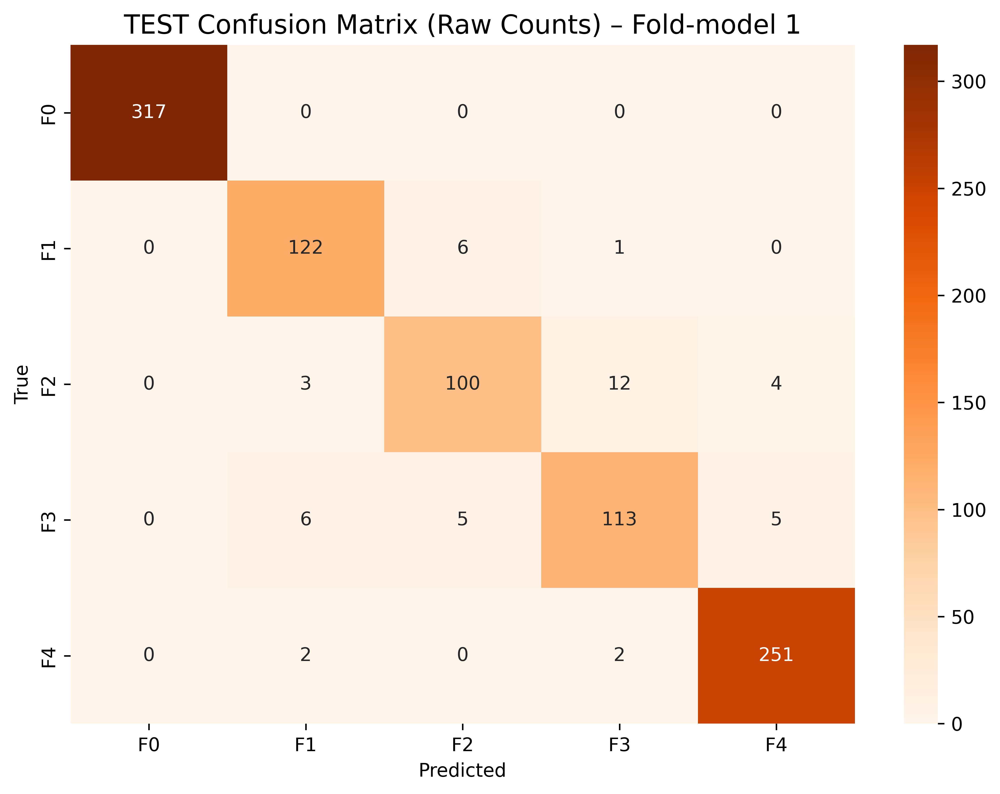

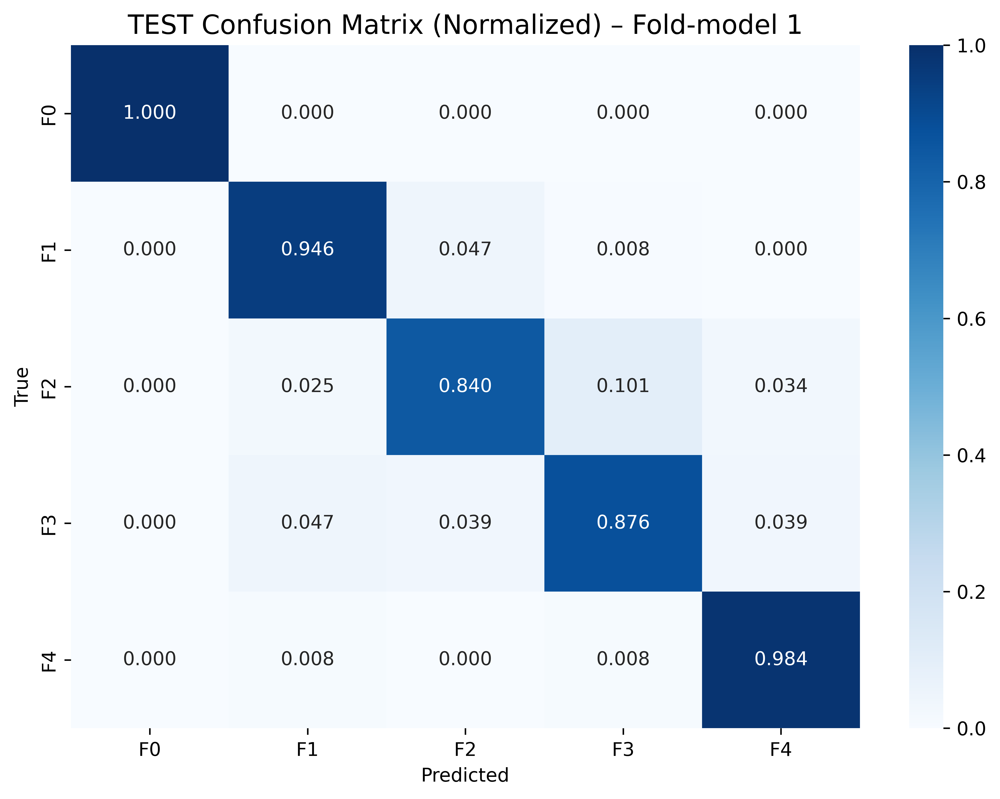


📄 Classification Report (Fold-model 1 on TEST):
              precision    recall  f1-score   support

          F0     1.0000    1.0000    1.0000       317
          F1     0.9173    0.9457    0.9313       129
          F2     0.9009    0.8403    0.8696       119
          F3     0.8828    0.8760    0.8794       129
          F4     0.9654    0.9843    0.9748       255

    accuracy                         0.9515       949
   macro avg     0.9333    0.9293    0.9310       949
weighted avg     0.9511    0.9515    0.9511       949


🔹 Fold-model 2 on TEST set...
DenseNet feat channels: 1024
✅ Fold 2 TEST Accuracy: 0.9547
✅ Fold 2 TEST QWK:      0.9808


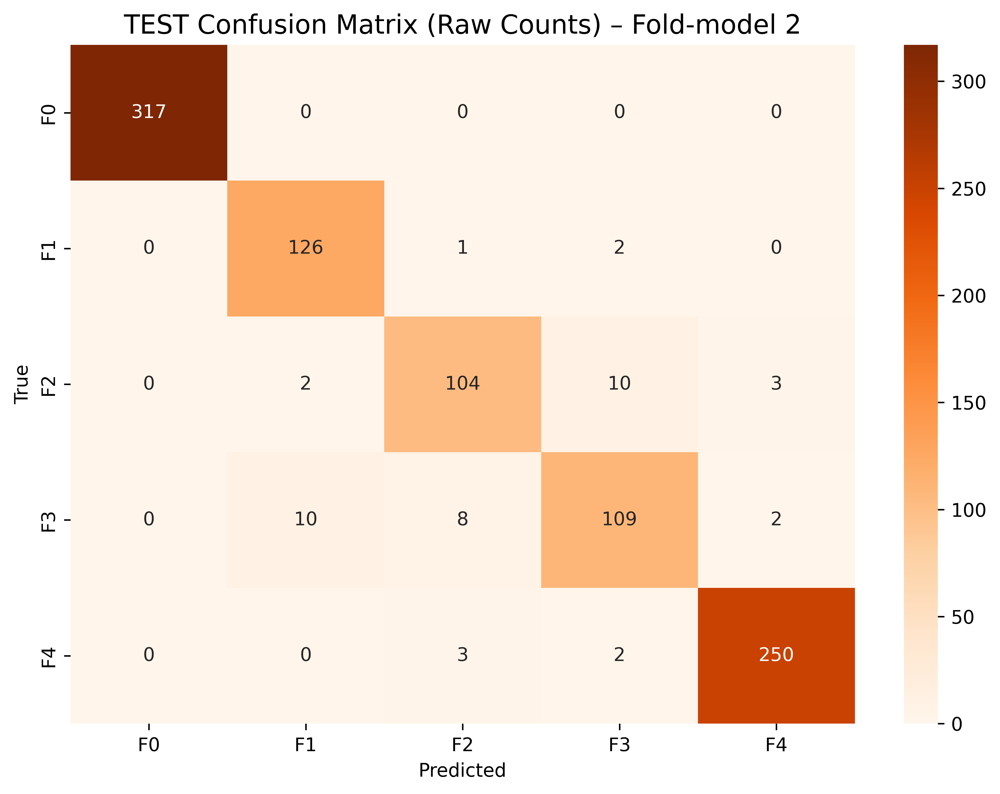

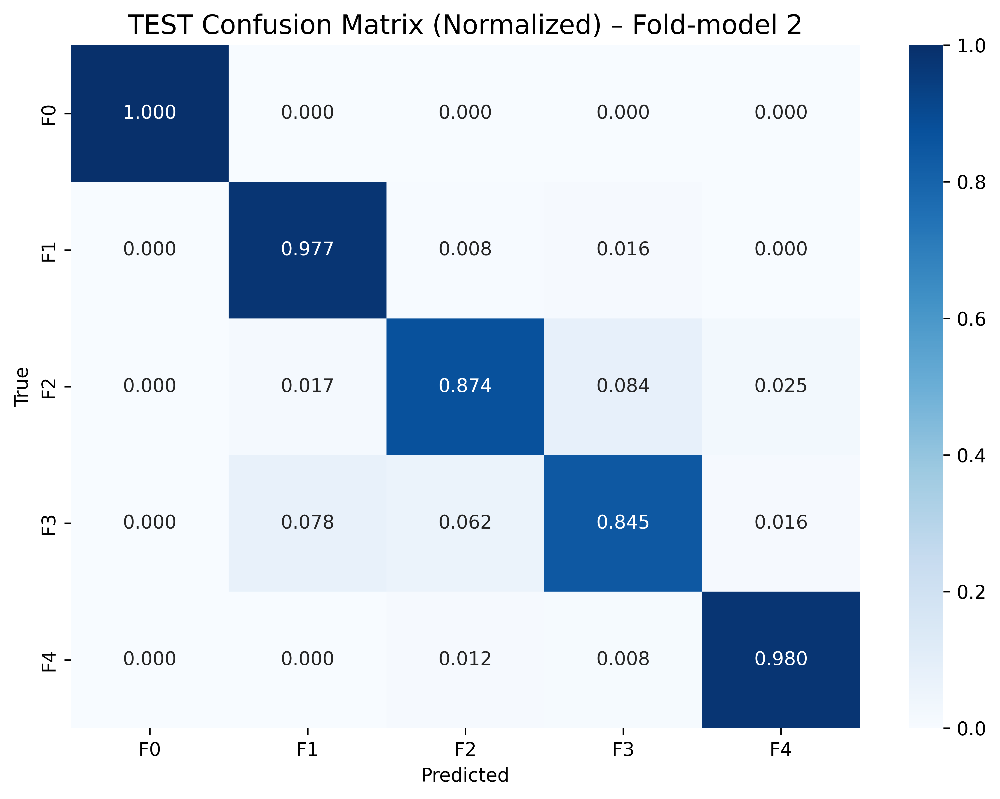


📄 Classification Report (Fold-model 2 on TEST):
              precision    recall  f1-score   support

          F0     1.0000    1.0000    1.0000       317
          F1     0.9130    0.9767    0.9438       129
          F2     0.8966    0.8739    0.8851       119
          F3     0.8862    0.8450    0.8651       129
          F4     0.9804    0.9804    0.9804       255

    accuracy                         0.9547       949
   macro avg     0.9352    0.9352    0.9349       949
weighted avg     0.9545    0.9547    0.9543       949


🔹 Fold-model 3 on TEST set...
DenseNet feat channels: 1024
✅ Fold 3 TEST Accuracy: 0.9473
✅ Fold 3 TEST QWK:      0.9805


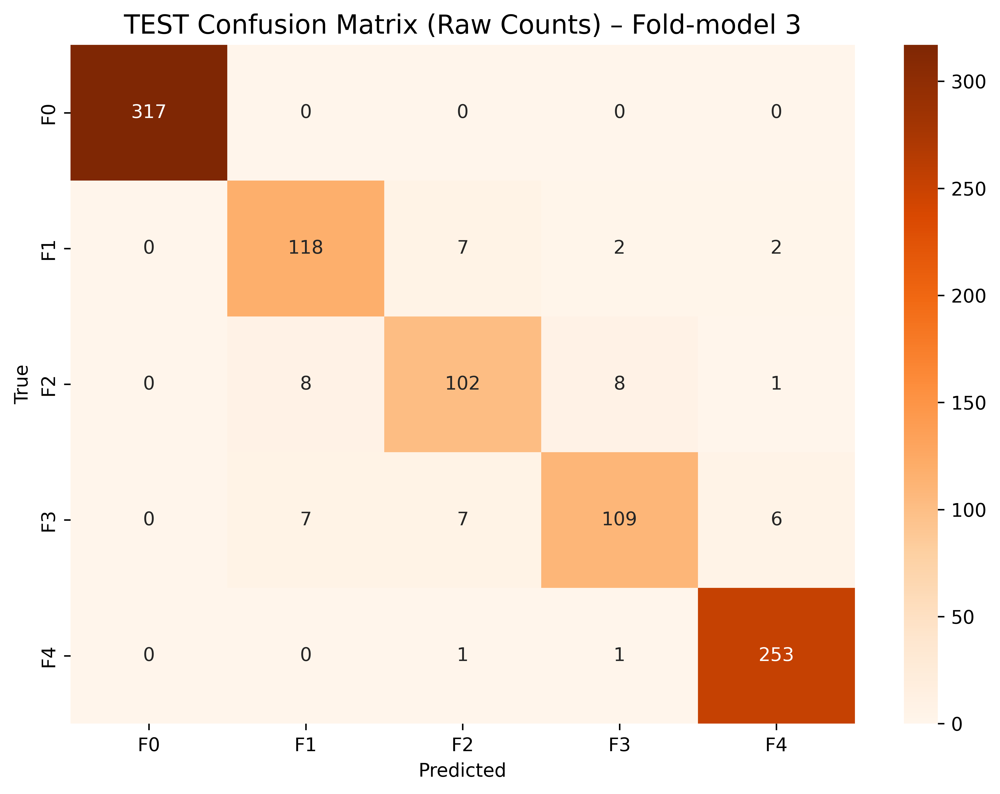

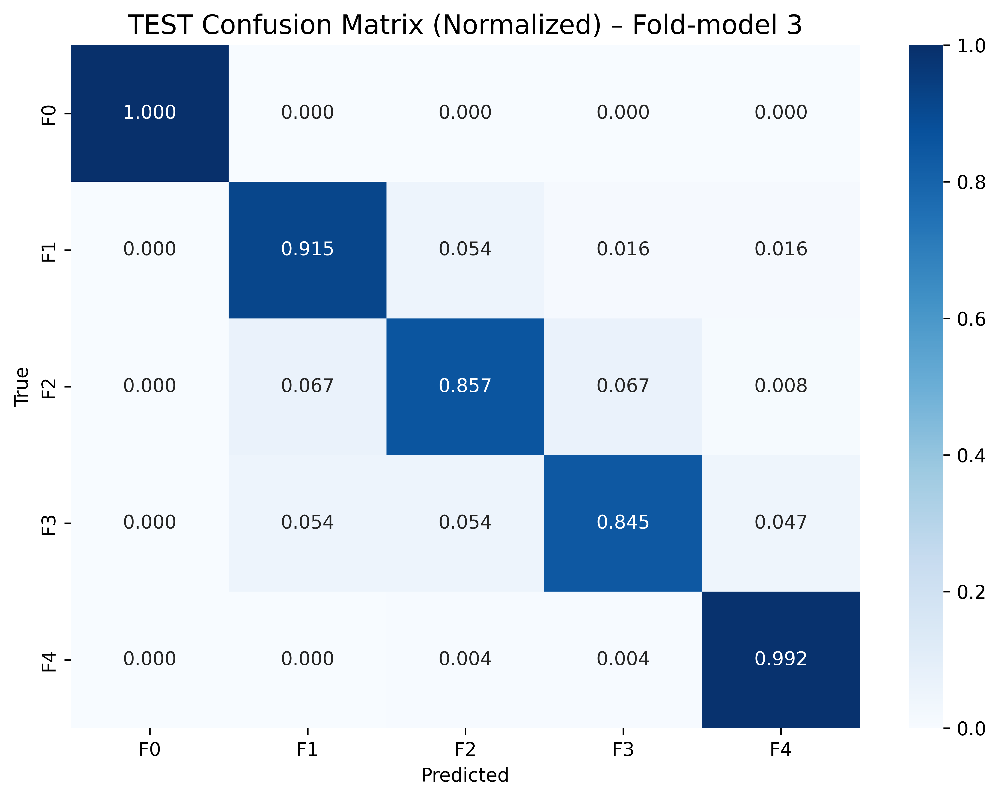


📄 Classification Report (Fold-model 3 on TEST):
              precision    recall  f1-score   support

          F0     1.0000    1.0000    1.0000       317
          F1     0.8872    0.9147    0.9008       129
          F2     0.8718    0.8571    0.8644       119
          F3     0.9083    0.8450    0.8755       129
          F4     0.9656    0.9922    0.9787       255

    accuracy                         0.9473       949
   macro avg     0.9266    0.9218    0.9239       949
weighted avg     0.9469    0.9473    0.9469       949


📊 OVERALL (Aggregated) TEST PERFORMANCE
⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.
✅ Overall Accuracy: 0.9512
✅ Overall QWK:      0.9809


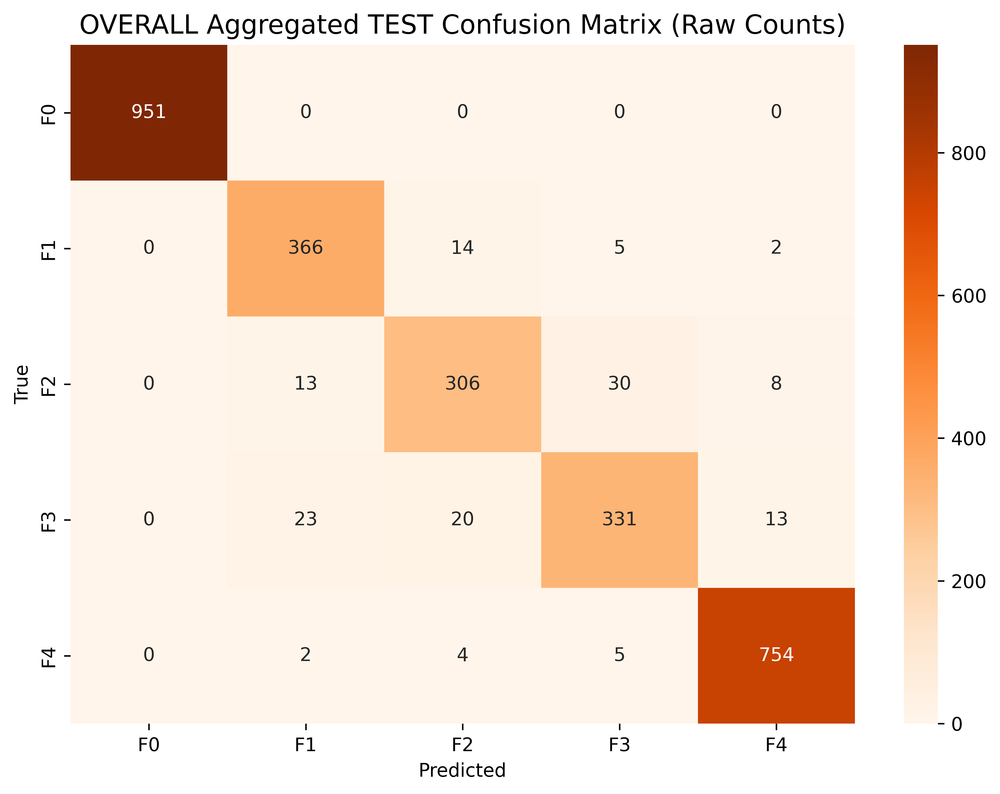

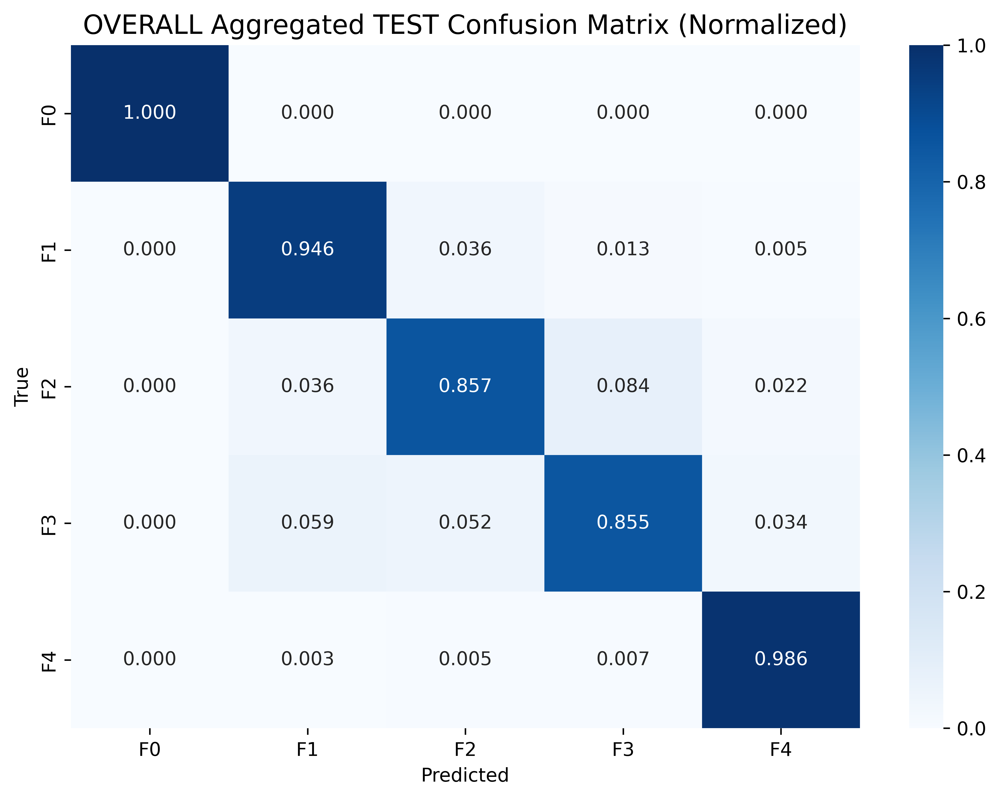


📄 Classification Report (OVERALL aggregated TEST):
              precision    recall  f1-score   support

          F0     1.0000    1.0000    1.0000       951
          F1     0.9059    0.9457    0.9254       387
          F2     0.8895    0.8571    0.8730       357
          F3     0.8922    0.8553    0.8734       387
          F4     0.9704    0.9856    0.9780       765

    accuracy                         0.9512      2847
   macro avg     0.9316    0.9288    0.9300      2847
weighted avg     0.9508    0.9512    0.9508      2847



In [11]:
# ============================
# OPTIONAL: TEST SET RESULTS PER FOLD MODEL + OVERALL (SGN + DenseNet)
# (Fold-model-on-test; NOT CV validation)
# ============================

import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import (
    confusion_matrix, classification_report,
    accuracy_score, cohen_kappa_score
)

print("📌 Generating PER-FOLD (fold-model-on-test) and OVERALL confusion matrices (SGN)...")

# ---------- Load model function ----------
def load_sgn_model(path):
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)  # ✅ your SGN model class
    model.load_state_dict(torch.load(path, map_location=CFG.DEVICE))
    model.eval()
    return model

# ---------- Model weight files (from your training loop save name) ----------
fold_models = [
    "densenet_sgn_fold1_best.pth",
    "densenet_sgn_fold2_best.pth",
    "densenet_sgn_fold3_best.pth"
]

# Optional: check files exist (prevents crash)
for p in fold_models:
    if not os.path.exists(p):
        print(f"⚠️ Warning: missing weight file -> {p}")

# ---------- TEST loader ----------
test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

# Class names
class_names = list(class_map.keys()) if "class_map" in globals() else ['F0','F1','F2','F3','F4']

all_true, all_pred = [], []

# ============================
# PER-FOLD MODEL → TEST RESULTS
# ============================
for fold, model_path in enumerate(fold_models, start=1):
    if not os.path.exists(model_path):
        print(f"\n⚠️ Skipping Fold-model {fold} because file not found: {model_path}")
        continue

    print(f"\n🔹 Fold-model {fold} on TEST set...")
    model = load_sgn_model(model_path)

    y_true_fold, y_pred_fold = [], []

    with torch.no_grad():
        for imgs, labels in test_loader:
            imgs = imgs.to(CFG.DEVICE)
            outputs = model(imgs)
            preds = outputs.argmax(dim=1).cpu().numpy()

            y_pred_fold.extend(preds)
            y_true_fold.extend(labels.numpy())

    # Metrics
    fold_acc = accuracy_score(y_true_fold, y_pred_fold)
    fold_qwk = cohen_kappa_score(y_true_fold, y_pred_fold, weights="quadratic")

    print(f"✅ Fold {fold} TEST Accuracy: {fold_acc:.4f}")
    print(f"✅ Fold {fold} TEST QWK:      {fold_qwk:.4f}")

    # Save for overall (NOTE: test set repeated 3 times -> overall is NOT ensemble)
    all_true.extend(y_true_fold)
    all_pred.extend(y_pred_fold)

    # Confusion matrix
    cm_raw = confusion_matrix(y_true_fold, y_pred_fold)

    # RAW (orange)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(
        cm_raw, annot=True, fmt="d", cmap="Oranges",
        xticklabels=class_names, yticklabels=class_names
    )
    plt.title(f"TEST Confusion Matrix (Raw Counts) – Fold-model {fold}", fontsize=14)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    # NORMALIZED (blue)
    cm_norm = cm_raw.astype(float) / (cm_raw.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(
        cm_norm, annot=True, fmt=".3f", cmap="Blues",
        xticklabels=class_names, yticklabels=class_names
    )
    plt.title(f"TEST Confusion Matrix (Normalized) – Fold-model {fold}", fontsize=14)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print(f"\n📄 Classification Report (Fold-model {fold} on TEST):")
    print(classification_report(y_true_fold, y_pred_fold, target_names=class_names, digits=4))

# ============================
# "OVERALL" (Aggregated) — NOT ENSEMBLE
# ============================
all_true = np.array(all_true)
all_pred = np.array(all_pred)

if len(all_true) == 0:
    print("\n❌ No predictions collected. Check your weight paths and test_loader.")
else:
    overall_acc = accuracy_score(all_true, all_pred)
    overall_qwk = cohen_kappa_score(all_true, all_pred, weights="quadratic")

    print("\n========================================")
    print("📊 OVERALL (Aggregated) TEST PERFORMANCE")
    print("⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.")
    print(f"✅ Overall Accuracy: {overall_acc:.4f}")
    print(f"✅ Overall QWK:      {overall_qwk:.4f}")
    print("========================================")

    cm_overall = confusion_matrix(all_true, all_pred)

    # RAW overall (orange)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(
        cm_overall, annot=True, fmt="d", cmap="Oranges",
        xticklabels=class_names, yticklabels=class_names
    )
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Raw Counts)", fontsize=14)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    # NORMALIZED overall (blue)
    cm_overall_norm = cm_overall.astype(float) / (cm_overall.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(
        cm_overall_norm, annot=True, fmt=".3f", cmap="Blues",
        xticklabels=class_names, yticklabels=class_names
    )
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Normalized)", fontsize=14)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print("\n📄 Classification Report (OVERALL aggregated TEST):")
    print(classification_report(all_true, all_pred, target_names=class_names, digits=4))



🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + SGN...
DenseNet feat channels: 1024
DenseNet feat channels: 1024
DenseNet feat channels: 1024

📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + SGN
✅ Test Accuracy: 0.9810
✅ Test QWK:      0.9941

📄 Classification Report:
              precision    recall  f1-score   support

          F0     1.0000    1.0000    1.0000       317
          F1     0.9699    1.0000    0.9847       129
          F2     0.9649    0.9244    0.9442       119
          F3     0.9449    0.9302    0.9375       129
          F4     0.9884    1.0000    0.9942       255

    accuracy                         0.9810       949
   macro avg     0.9736    0.9709    0.9721       949
weighted avg     0.9809    0.9810    0.9809       949



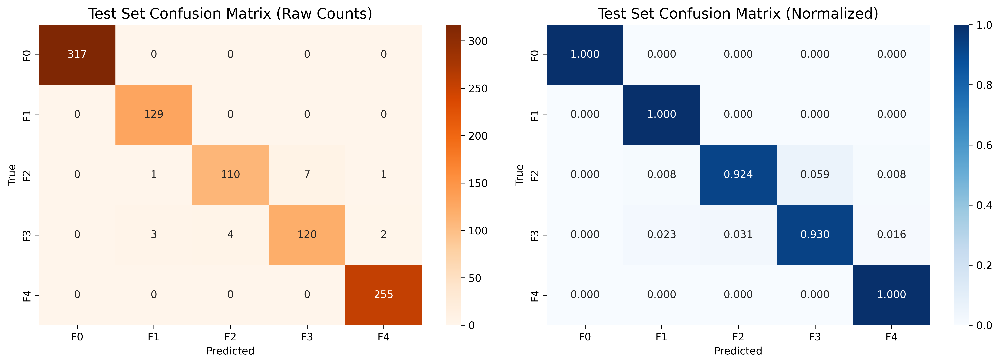


✅ Saved: test_confusion_matrix_ensemble_sgn.png
✅ all_probs saved in memory for ROC/AUC cell.


In [10]:
# ============================
# TEST SET EVALUATION (ENSEMBLE) — MAIN RESULT (SGN + DenseNet) (600 DPI)
# ============================

import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from sklearn.metrics import accuracy_score, cohen_kappa_score, confusion_matrix, classification_report
from torch.utils.data import DataLoader

print("\n🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + SGN...")

# -------- Load test data --------
test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

# -------- Load ensemble models --------
fold_models = [
    "densenet_sgn_fold1_best.pth",
    "densenet_sgn_fold2_best.pth",
    "densenet_sgn_fold3_best.pth"
]

# Safety check (avoid silent mistakes)
for p in fold_models:
    if not os.path.exists(p):
        print(f"⚠️ Missing weight file: {p}")

models = []
for path in fold_models:
    if not os.path.exists(path):
        continue

    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)   # ✅ SGN model
    model.load_state_dict(torch.load(path, map_location=CFG.DEVICE))
    model.eval()
    models.append(model)

if len(models) == 0:
    raise FileNotFoundError("❌ No SGN fold models loaded. Check filenames/paths.")

# -------- Inference (store probs too) --------
all_labels, all_preds, all_probs = [], [], []

with torch.no_grad():
    for imgs, labels in test_loader:
        imgs = imgs.to(CFG.DEVICE)

        probs = torch.zeros((imgs.size(0), CFG.NUM_CLASSES), device=CFG.DEVICE)
        for m in models:
            probs += torch.softmax(m(imgs), dim=1)
        probs /= len(models)

        preds = torch.argmax(probs, dim=1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.numpy())
        all_probs.extend(probs.cpu().numpy())   # ✅ for ROC/AUC later

# Convert to numpy
all_labels = np.array(all_labels)
all_preds  = np.array(all_preds)
all_probs  = np.array(all_probs)

# -------- Metrics --------
acc = accuracy_score(all_labels, all_preds)
qwk = cohen_kappa_score(all_labels, all_preds, weights="quadratic")

print("\n========================================")
print("📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + SGN")
print(f"✅ Test Accuracy: {acc:.4f}")
print(f"✅ Test QWK:      {qwk:.4f}")
print("========================================")

# Class names
class_names = list(class_map.keys()) if "class_map" in globals() else ['F0','F1','F2','F3','F4']

print("\n📄 Classification Report:")
print(classification_report(
    all_labels,
    all_preds,
    target_names=class_names,
    digits=4
))

# ============================
# CONFUSION MATRICES (TEST SET) — 600 DPI
# ============================
cm = confusion_matrix(all_labels, all_preds)

fig, ax = plt.subplots(1, 2, figsize=(14, 5), dpi=600)

# ---- RAW CONFUSION MATRIX (ORANGE) ----
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Oranges",
    xticklabels=class_names,
    yticklabels=class_names,
    ax=ax[0]
)
ax[0].set_title("Test Set Confusion Matrix (Raw Counts)", fontsize=14)
ax[0].set_xlabel("Predicted")
ax[0].set_ylabel("True")

# ---- NORMALIZED CONFUSION MATRIX (BLUE) ----
cm_norm = cm.astype(float) / (cm.sum(axis=1, keepdims=True) + 1e-8)
sns.heatmap(
    cm_norm,
    annot=True,
    fmt=".3f",
    cmap="Blues",
    xticklabels=class_names,
    yticklabels=class_names,
    ax=ax[1]
)
ax[1].set_title("Test Set Confusion Matrix (Normalized)", fontsize=14)
ax[1].set_xlabel("Predicted")
ax[1].set_ylabel("True")

plt.tight_layout()
plt.show()

# OPTIONAL: SAVE FIGURE FOR PAPER
fig.savefig(
    "test_confusion_matrix_ensemble_sgn.png",
    dpi=600,
    bbox_inches="tight"
)

print("\n✅ Saved: test_confusion_matrix_ensemble_sgn.png")
print("✅ all_probs saved in memory for ROC/AUC cell.")


🚀 Generating ROC/AUC Curves... (DenseNet + SGN)

📊 ROC/AUC RESULTS (TEST SET) — DenseNet + SGN
✅ Micro-average AUC: 0.9989
✅ Macro-average AUC: 0.9980
   - Class F0 AUC: 1.0000
   - Class F1 AUC: 0.9998
   - Class F2 AUC: 0.9945
   - Class F3 AUC: 0.9951
   - Class F4 AUC: 1.0000


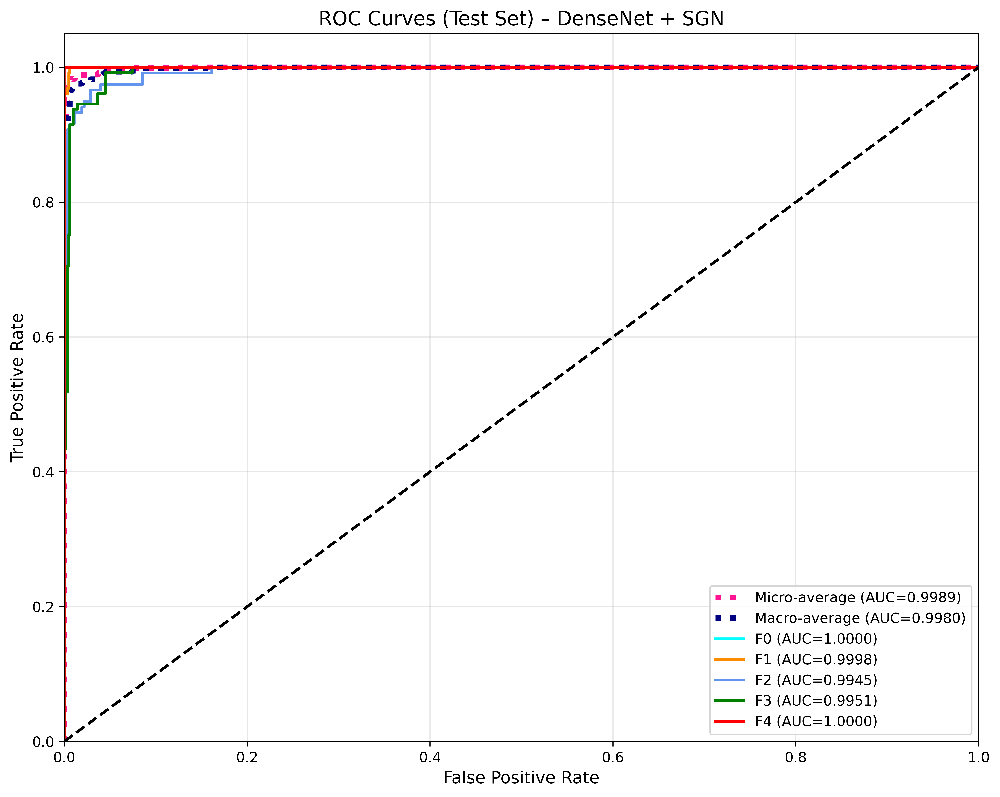

✅ Saved: roc_auc_densenet_sgn_test.png


In [12]:
# --- CELL 11: ROC/AUC CURVES (DenseNet + SGN) — 600 DPI ---
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from itertools import cycle
import numpy as np
import matplotlib.pyplot as plt

print("🚀 Generating ROC/AUC Curves... (DenseNet + SGN)")

# Safety check
if 'all_probs' not in locals() or 'all_labels' not in locals():
    print("❌ Error: Predictions not found. Please run SGN ENSEMBLE TEST evaluation cell first!")
else:
    # 1. Binarize labels
    y_test = label_binarize(all_labels, classes=range(CFG.NUM_CLASSES))
    y_score = all_probs
    n_classes = y_test.shape[1]

    # 2. Compute ROC/AUC per class
    fpr, tpr, roc_auc = dict(), dict(), dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # 3. Micro-average ROC/AUC
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # 4. Macro-average ROC/AUC
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    mean_tpr /= n_classes

    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # 5. Print AUC values
    print(f"\n{'='*40}")
    print("📊 ROC/AUC RESULTS (TEST SET) — DenseNet + SGN")
    print(f"✅ Micro-average AUC: {roc_auc['micro']:.4f}")
    print(f"✅ Macro-average AUC: {roc_auc['macro']:.4f}")

    class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(n_classes)]
    for i in range(n_classes):
        print(f"   - Class {class_names[i]} AUC: {roc_auc[i]:.4f}")
    print(f"{'='*40}")

    # 6. Plot ROC curves (600 DPI)
    fig = plt.figure(figsize=(10, 8), dpi=600)

    # Micro & Macro
    plt.plot(
        fpr["micro"], tpr["micro"],
        label=f'Micro-average (AUC={roc_auc["micro"]:.4f})',
        color='deeppink', linestyle=':', lw=4
    )

    plt.plot(
        fpr["macro"], tpr["macro"],
        label=f'Macro-average (AUC={roc_auc["macro"]:.4f})',
        color='navy', linestyle=':', lw=4
    )

    # Per-class ROC
    colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'green', 'red'])
    for i, color in zip(range(n_classes), colors):
        plt.plot(
            fpr[i], tpr[i],
            color=color, lw=2,
            label=f'{class_names[i]} (AUC={roc_auc[i]:.4f})'
        )

    # Diagonal
    plt.plot([0, 1], [0, 1], 'k--', lw=2)

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12)
    plt.ylabel('True Positive Rate', fontsize=12)
    plt.title('ROC Curves (Test Set) – DenseNet + SGN', fontsize=14)
    plt.legend(loc="lower right", fontsize=10)
    plt.grid(alpha=0.3)

    plt.tight_layout()
    plt.show()

    # OPTIONAL: save for paper
    fig.savefig(
        "roc_auc_densenet_sgn_test.png",
        dpi=600,
        bbox_inches="tight"
    )
    print("✅ Saved: roc_auc_densenet_sgn_test.png")


🚀 Loading SGN Ensemble Models...
DenseNet feat channels: 1024
  ✅ Loaded Fold 1
DenseNet feat channels: 1024
  ✅ Loaded Fold 2
DenseNet feat channels: 1024
  ✅ Loaded Fold 3
✅ ensemble_sgn function is ready!
📊 Running Interface Test on Test Set (Random Batch)...


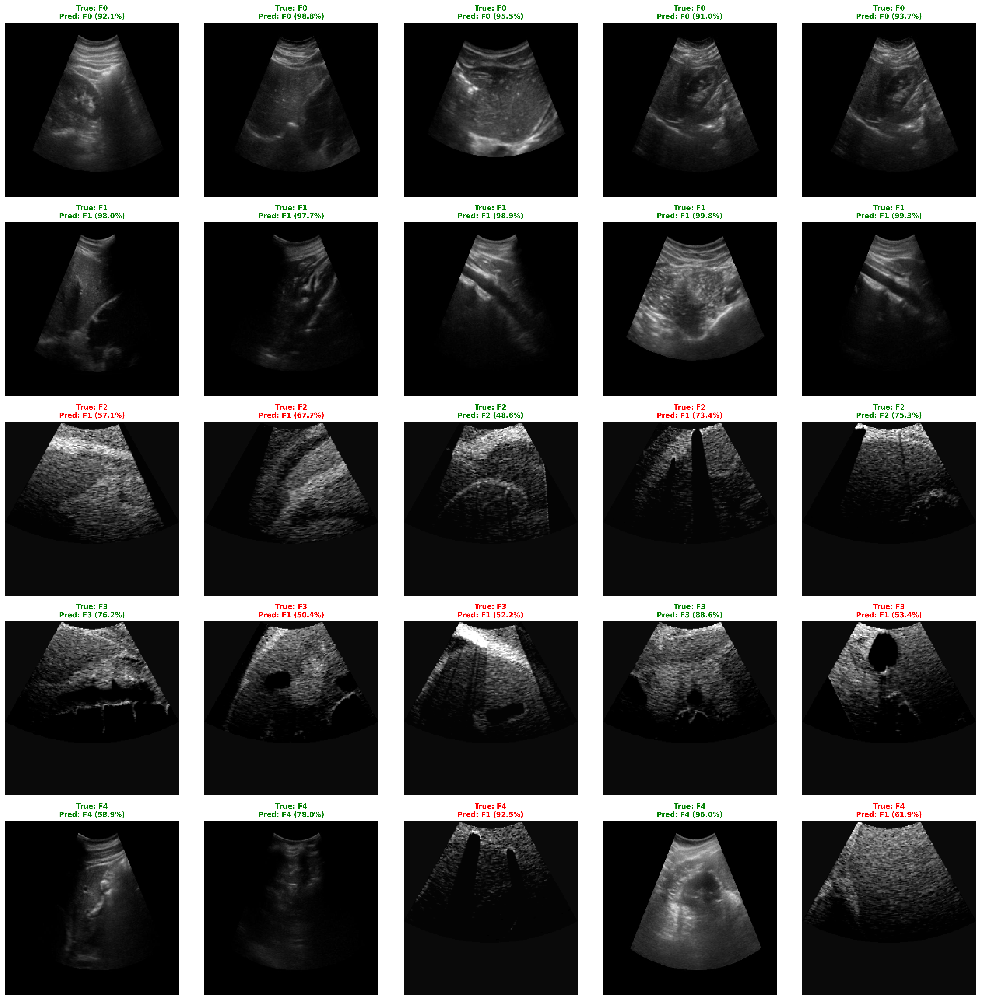

In [48]:
# --- CELL 12A: DEFINE ENSEMBLE PREDICTION FUNCTION ---
import torch
import torch.nn.functional as F
import os

print("🚀 Loading SGN Ensemble Models...")

# 1. Define Model Loading Helper
def load_sgn_model(path):
    if not os.path.exists(path):
        print(f"⚠️ Warning: Weights not found at {path}")
        return None
    # Ensure DenseNet_kNNSGN is defined in previous cells
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    model.load_state_dict(torch.load(path, map_location=CFG.DEVICE))
    model.eval()
    return model

# 2. Load All Folds
models = []
for i in range(1, CFG.N_FOLDS + 1):
    path = f"densenet_sgn_fold{i}_best.pth"
    m = load_sgn_model(path)
    if m: 
        models.append(m)
        print(f"  ✅ Loaded Fold {i}")

if not models:
    print("❌ No models loaded! Using random weights for demo/debugging.")
    # Fallback for debugging if weights missing
    m = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    models.append(m)

# 3. Define Ensemble Prediction Function
def ensemble_sgn(img_tensor):
    """
    Takes [1, 3, H, W] tensor, returns [1, num_classes] probabilities (averaged)
    """
    avg_probs = None
    with torch.no_grad():
        for m in models:
            logits = m(img_tensor)
            probs = F.softmax(logits, dim=1)
            if avg_probs is None:
                avg_probs = probs
            else:
                avg_probs += probs
        avg_probs /= len(models)
    return avg_probs

print("✅ ensemble_sgn function is ready!")


# --- CELL 12B: BALANCED INTERFACE TEST (RANDOM EVERY RUN) ---
import numpy as np
import cv2
import matplotlib.pyplot as plt

def predict_interface_5_per_class(df_data, per_class=5, dpi=300):
    # FIX: REMOVED FIXED SEED to ensure randomness every run
    # np.random.seed(seed) <--- DELETED

    class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]
    n_classes = CFG.NUM_CLASSES

    # Collect samples: 5 per class
    rows = []
    for c in range(n_classes):
        sub = df_data[df_data["diagnosis"] == c]
        if len(sub) == 0:
            print(f"⚠️ No samples for class {class_names[c]} in df_data, skipping.")
            continue

        take = min(per_class, len(sub))
        # Random sample without fixed state
        rows_c = sub.sample(take).reset_index(drop=True)
        for j in range(take):
            rows.append(rows_c.loc[j])

    if len(rows) == 0:
        print("❌ No rows selected. Check df_data and diagnosis column.")
        return

    # Plot as grid: n_classes rows × per_class cols
    cols = per_class
    rows_count = int(np.ceil(len(rows) / cols))

    fig, axes = plt.subplots(rows_count, cols, figsize=(4*cols, 4*rows_count), dpi=dpi)
    
    # Handle single row case
    if rows_count == 1: axes = axes.reshape(1, -1)
    elif cols == 1: axes = axes.reshape(-1, 1)
    
    axes = np.array(axes).reshape(rows_count, cols)

    idx = 0
    for r in range(rows_count):
        for c in range(cols):
            ax = axes[r, c]
            ax.axis("off")

            if idx >= len(rows):
                continue

            row = rows[idx]
            idx += 1

            # Load & Preprocess
            img = cv2.imread(row.image_path)
            if img is None:
                ax.set_title("⚠️ Image Load Error", fontsize=10)
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            rsz = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

            # Transform
            t = valid_tfms(image=rsz)["image"].unsqueeze(0).to(CFG.DEVICE)

            # Predict using the newly defined function
            with torch.no_grad():
                p = ensemble_sgn(t)[0].detach().cpu().numpy()

            pred = int(np.argmax(p))
            conf = float(p[pred] * 100.0)
            true = int(row.diagnosis)

            col = "green" if pred == true else "red"
            ax.imshow(rsz)
            ax.set_title(
                f"True: {class_names[true]}\nPred: {class_names[pred]} ({conf:.1f}%)",
                color=col, fontweight="bold", fontsize=10
            )

    plt.tight_layout()
    plt.show()

# ✅ Run balanced test (Fresh random images every time)
print("📊 Running Interface Test on Test Set (Random Batch)...")
predict_interface_5_per_class(test_df, per_class=5, dpi=300)

🚀 Generating 6-Panel XAI for DenseNet121 + SGN...
✅ Loading weights: densenet_sgn_fold1_best.pth
DenseNet feat channels: 1024
🎲 Picking fresh random samples...

--- Class F0 (Image: a5709.jpg) ---


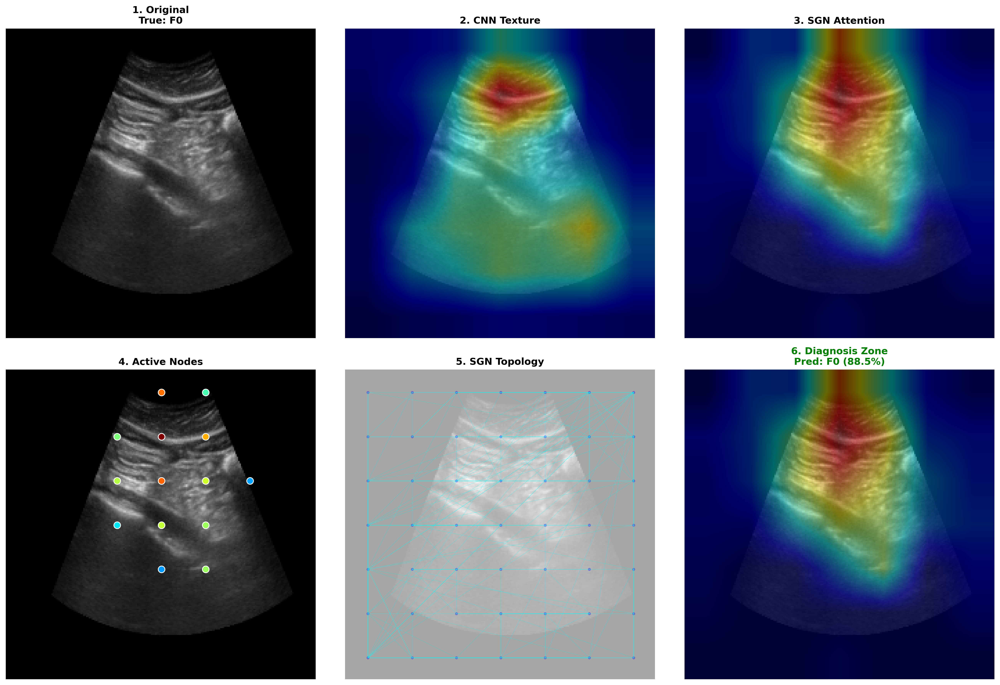


--- Class F1 (Image: ct3-25.png) ---


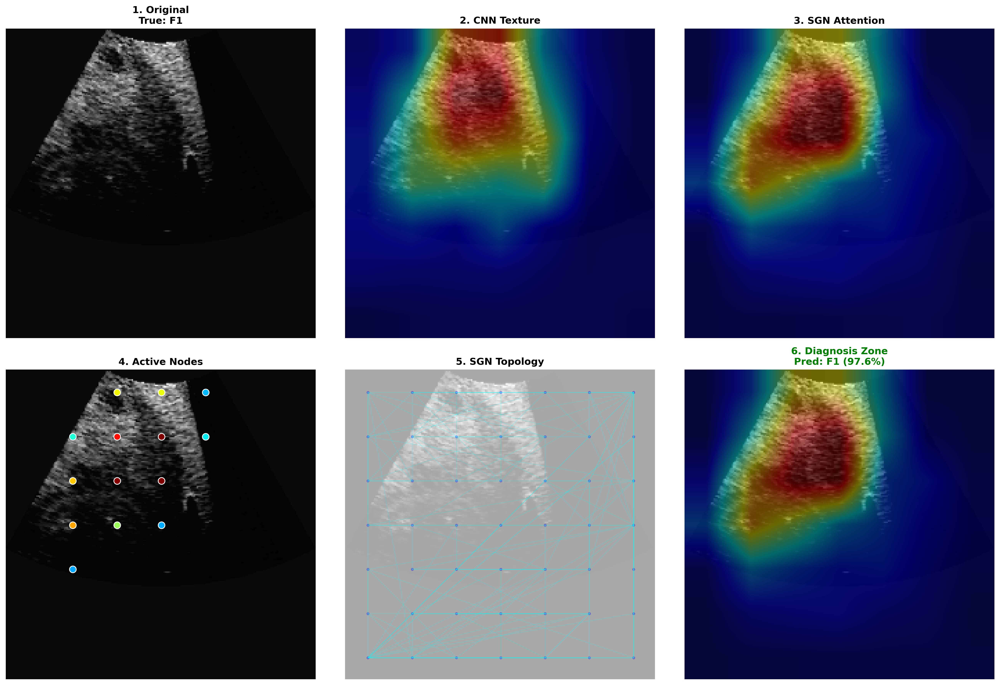


--- Class F2 (Image: ct4-66.png) ---


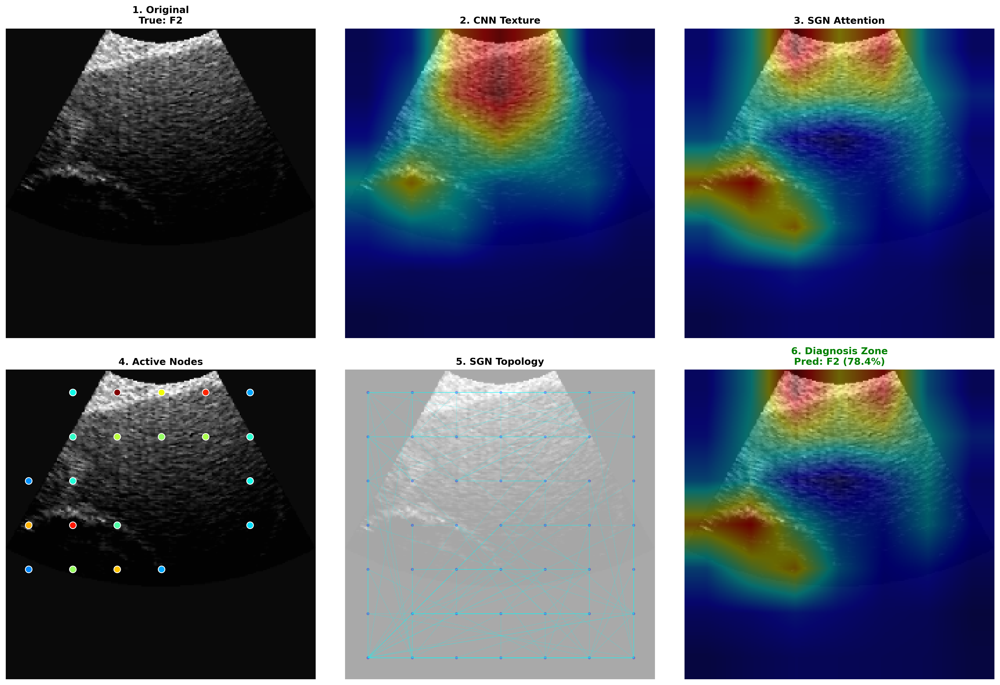


--- Class F3 (Image: ct11-49.png) ---


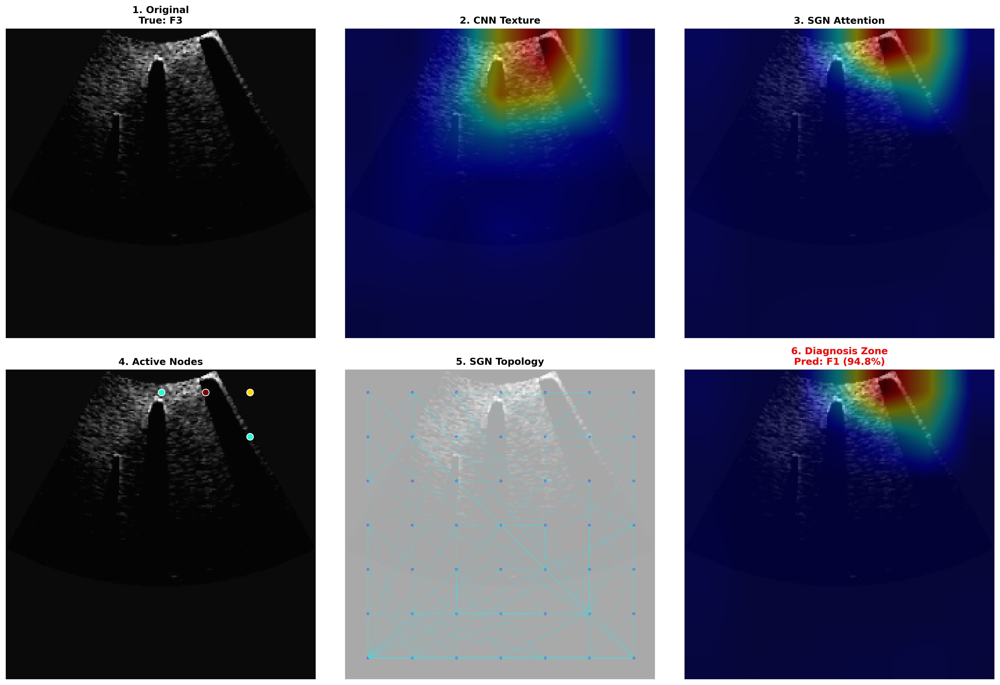


--- Class F4 (Image: i3232.jpg) ---


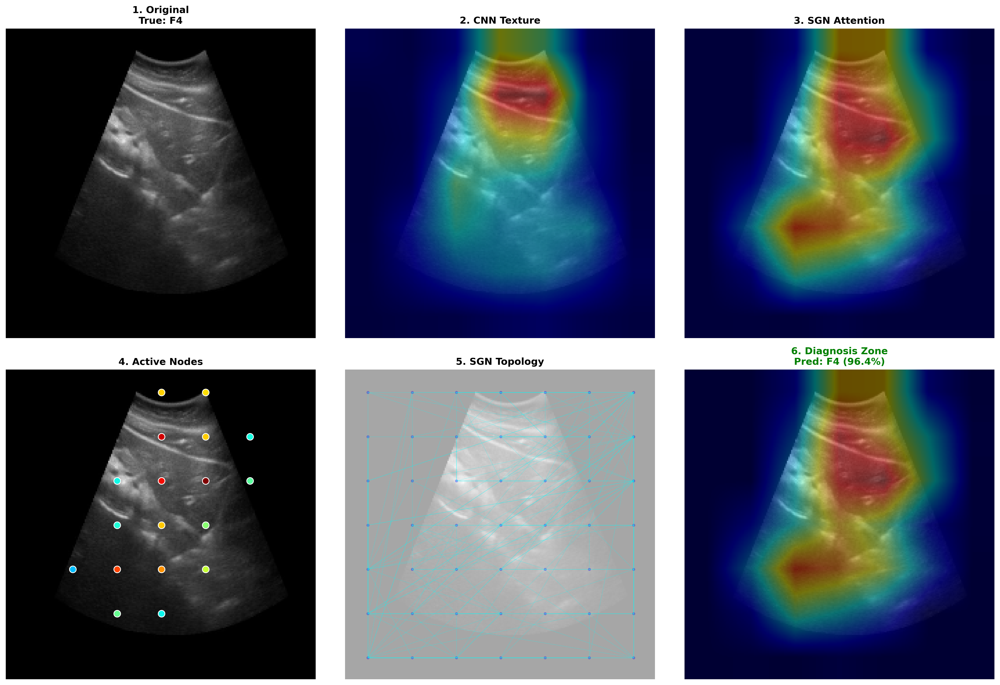

In [36]:
# --- CELL 13: 6-PANEL XAI VISUALIZATION (DenseNet + SGN) - RANDOM EVERY RUN ---
print("🚀 Generating 6-Panel XAI for DenseNet121 + SGN...")

import os
import cv2
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

# --------------------------------------------------
# 0) PICK A DF SAFELY
# --------------------------------------------------
def pick_df_for_xai():
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    if "test_df" in globals(): return test_df
    raise NameError("❌ No dataframe found.")

df_use = pick_df_for_xai()

# --------------------------------------------------
# 1) XAI EXTRACTION FUNCTION (SGN)
# --------------------------------------------------
def extract_sgn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, input, output):
        fmap = output[-1] if isinstance(output, (list, tuple)) else output
        fmaps.append(fmap)
        fmap.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "backbone"):
        raise AttributeError("❌ model.backbone not found.")

    h = model.backbone.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred = logits.argmax(1).item()
        conf = probs[0, pred].item()
        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    # Texture map
    fmap = fmaps[0].detach()
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = (tex - tex.min()) / (tex.max() - tex.min() + 1e-8)

    # Attention map
    grad = grads[0].detach()
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    # Graph topology (k-NN)
    with torch.no_grad():
        C, H, W = fmap.shape[1:]
        flat = fmap[0].view(C, -1).permute(1, 0)
        dist = torch.cdist(flat, flat)
        k = int(getattr(model, "k", 20))
        _, idx = dist.topk(k=k, largest=False)
        src = torch.arange(H * W, device=fmap.device).view(-1, 1).repeat(1, k).reshape(-1)
        dst = idx.reshape(-1)
        mask = src != dst
        edges = list(zip(src[mask].cpu().numpy(), dst[mask].cpu().numpy()))
        nodes = []
        for i in range(H * W):
            r, c = divmod(i, W)
            y = int((r + 0.5) * (CFG.IMG_SIZE / H))
            x = int((c + 0.5) * (CFG.IMG_SIZE / W))
            nodes.append((x, y))

    return tex, cam, nodes, edges, pred, conf

# --------------------------------------------------
# 2) HELPER: OVERLAY
# --------------------------------------------------
def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

# --------------------------------------------------
# 3) PLOTTING FUNCTION
# --------------------------------------------------
def plot_sgn_6_panel(img, tex, cam, nodes, edges, true_y, pred_y, conf, dpi=300):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)
    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    
    tex_rs = cv2.resize(tex, sz)
    cam_rs = cv2.resize(cam, sz)
    
    tex_overlay  = overlay_heatmap_on_image(img, tex_rs, 0.45, cv2.COLORMAP_JET)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs, 0.45, cv2.COLORMAP_JET)
    diag_overlay = overlay_heatmap_on_image(img, cam_rs, 0.40, cv2.COLORMAP_JET)
    
    font = {'weight': 'bold', 'size': 12}

    ax[0, 0].imshow(img)
    ax[0, 0].set_title(f"1. Original\nTrue: F{true_y}", font)

    ax[0, 1].imshow(tex_overlay)
    ax[0, 1].set_title("2. CNN Texture", font)

    ax[0, 2].imshow(cam_overlay)
    ax[0, 2].set_title("3. SGN Attention", font)

    ax[1, 0].imshow(img)
    flat = cam.flatten()
    for i, (nx, ny) in enumerate(nodes):
        if i < len(flat) and flat[i] > 0.25:
            ax[1, 0].scatter(nx, ny, c=[plt.cm.jet(flat[i])], s=70, edgecolors='w', zorder=2)
    ax[1, 0].set_title("4. Active Nodes", font)

    ax[1, 1].imshow(img, alpha=0.35)
    for i, (s, d) in enumerate(edges):
        if i % 2 == 0:
            x1, y1 = nodes[s]
            x2, y2 = nodes[d]
            ax[1, 1].plot([x1, x2], [y1, y2], c='cyan', alpha=0.25, lw=0.6)
    for nx, ny in nodes:
        ax[1, 1].scatter(nx, ny, c='blue', s=8, alpha=0.25)
    ax[1, 1].set_title("5. SGN Topology", font)

    ax[1, 2].imshow(diag_overlay)
    col = 'green' if true_y == pred_y else 'red'
    ax[1, 2].set_title(f"6. Diagnosis Zone\nPred: F{pred_y} ({conf*100:.1f}%)", font, color=col)

    for a in ax.flatten(): a.axis('off')
    plt.tight_layout()
    plt.show()

# --------------------------------------------------
# 4) RUN XAI EXAMPLES (RANDOM EVERY TIME)
# --------------------------------------------------
weights_path = "densenet_sgn_fold1_best.pth"
# Check Kaggle input if not in working directory
if not os.path.exists(weights_path):
    weights_path = "/kaggle/input/output-sgn-densnet/" + weights_path
    if not os.path.exists(weights_path):
        # Fallback to just the filename (maybe in current dir)
        weights_path = "densenet_sgn_fold1_best.pth"

if not os.path.exists(weights_path):
    print(f"⚠️ Weights not found at {weights_path}. Using random weights for DEMO.")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
else:
    print(f"✅ Loading weights: {weights_path}")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))

model.eval()

# FIX: Explicitly ensuring randomness by using a dynamic random_state
print("🎲 Picking fresh random samples...")

for c in range(CFG.NUM_CLASSES):
    subset = df_use[df_use.diagnosis == c] if "diagnosis" in df_use.columns else df_use[df_use["diagnosis"] == c]
    if len(subset) == 0:
        continue

    # Pick a random sample using a random integer seed
    row = subset.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]

    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))
    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    print(f"\n--- Class F{c} (Image: {os.path.basename(row.image_path)}) ---")
    tex, cam, nodes, edges, pred, conf = extract_sgn_xai(model, t, true_label=c)
    plot_sgn_6_panel(img, tex, cam, nodes, edges, true_y=c, pred_y=pred, conf=conf, dpi=300)

🚀 Generating 6-Panel XAI for DenseNet121 + SGN...
✅ Loading weights: densenet_sgn_fold1_best.pth
DenseNet feat channels: 1024
🎲 Picking fresh random samples...

--- Class F0 (Image: a1393.jpg) ---


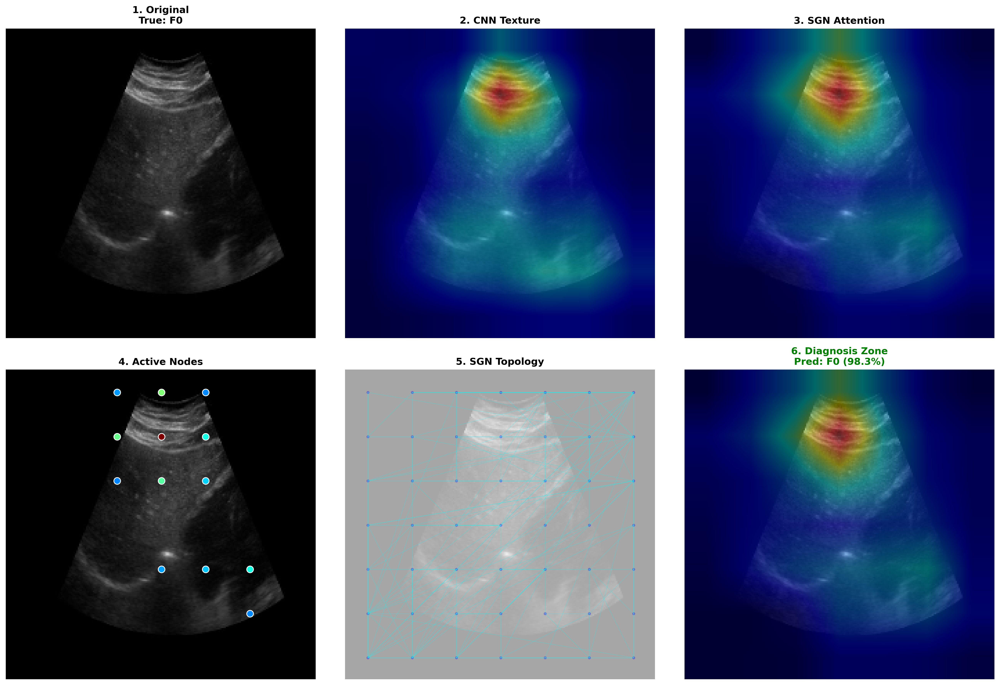


--- Class F1 (Image: c8713.jpg) ---


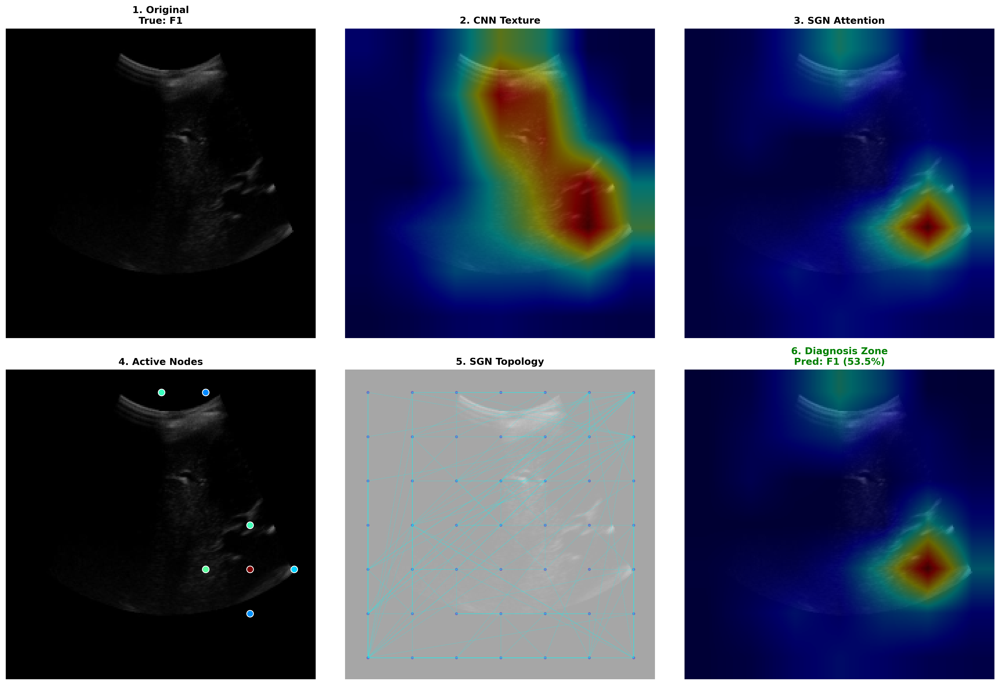


--- Class F2 (Image: ct4-30.png) ---


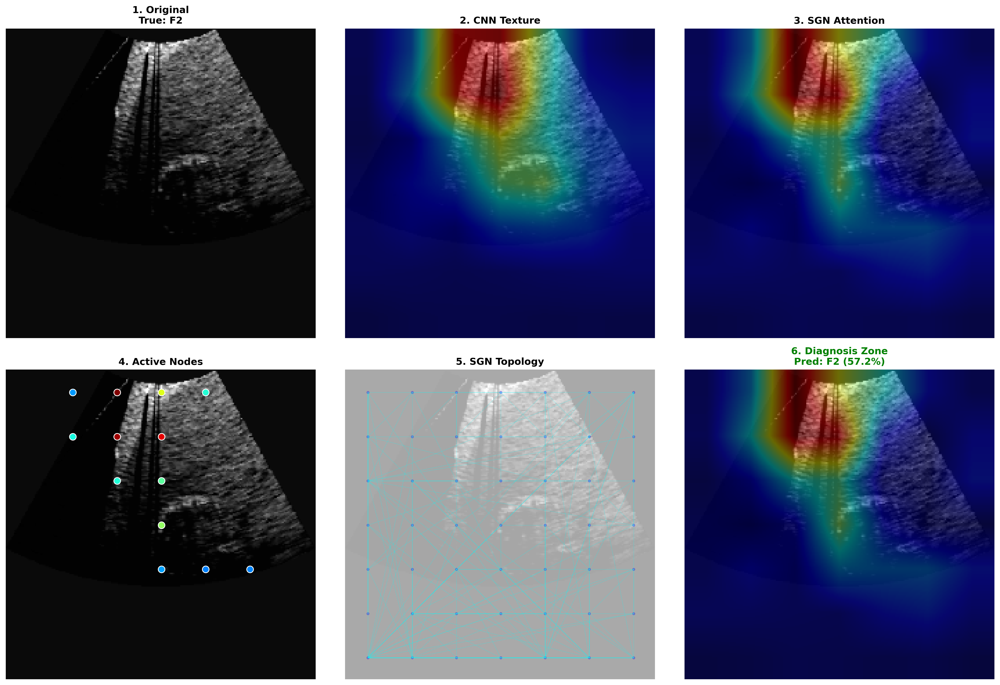


--- Class F3 (Image: y246.jpg) ---


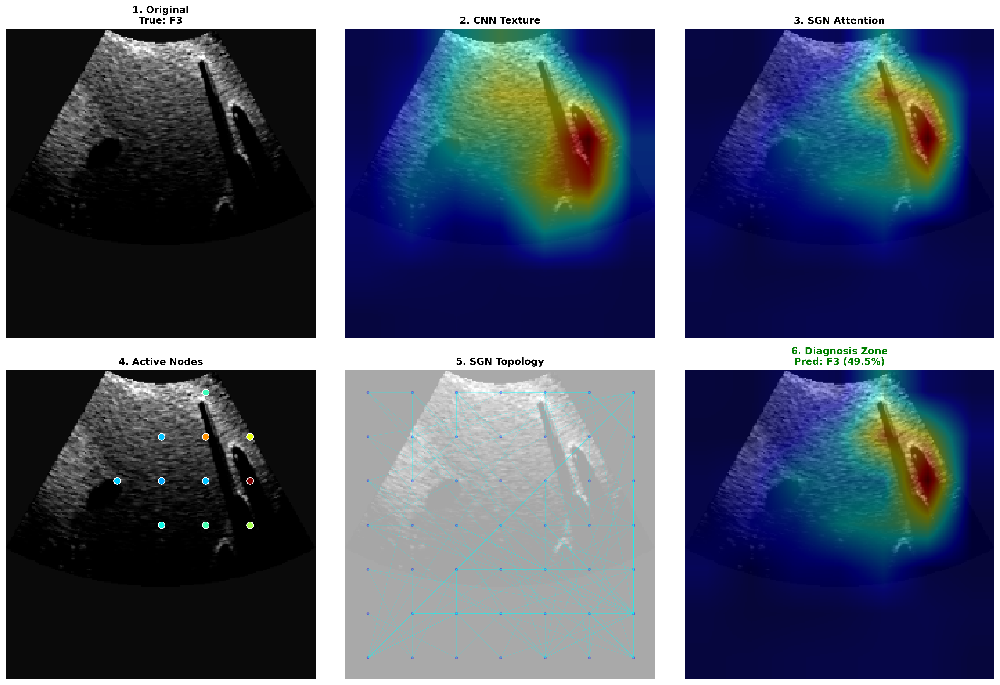


--- Class F4 (Image: j7271.jpg) ---


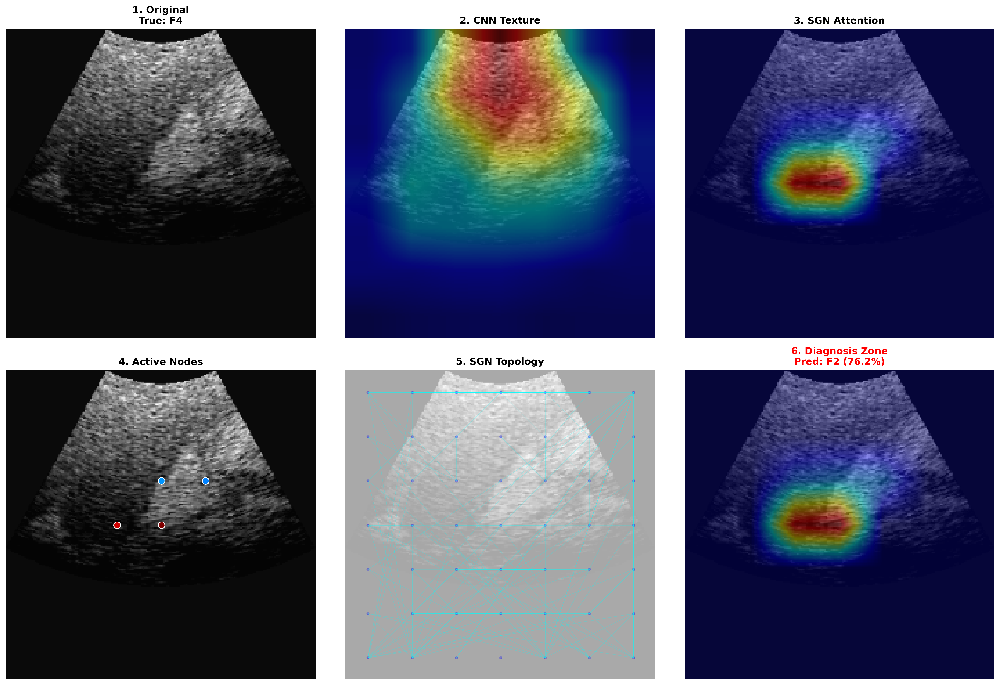

In [41]:
# --- CELL 13: 6-PANEL XAI VISUALIZATION (DenseNet + SGN) - RANDOM EVERY RUN ---
print("🚀 Generating 6-Panel XAI for DenseNet121 + SGN...")

import os
import cv2
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

# --------------------------------------------------
# 0) PICK A DF SAFELY
# --------------------------------------------------
def pick_df_for_xai():
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    if "test_df" in globals(): return test_df
    raise NameError("❌ No dataframe found.")

df_use = pick_df_for_xai()

# --------------------------------------------------
# 1) XAI EXTRACTION FUNCTION (SGN)
# --------------------------------------------------
def extract_sgn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, input, output):
        fmap = output[-1] if isinstance(output, (list, tuple)) else output
        fmaps.append(fmap)
        fmap.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "backbone"):
        raise AttributeError("❌ model.backbone not found.")

    h = model.backbone.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred = logits.argmax(1).item()
        conf = probs[0, pred].item()
        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    # Texture map
    fmap = fmaps[0].detach()
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = (tex - tex.min()) / (tex.max() - tex.min() + 1e-8)

    # Attention map
    grad = grads[0].detach()
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    # Graph topology (k-NN)
    with torch.no_grad():
        C, H, W = fmap.shape[1:]
        flat = fmap[0].view(C, -1).permute(1, 0)
        dist = torch.cdist(flat, flat)
        k = int(getattr(model, "k", 20))
        _, idx = dist.topk(k=k, largest=False)
        src = torch.arange(H * W, device=fmap.device).view(-1, 1).repeat(1, k).reshape(-1)
        dst = idx.reshape(-1)
        mask = src != dst
        edges = list(zip(src[mask].cpu().numpy(), dst[mask].cpu().numpy()))
        nodes = []
        for i in range(H * W):
            r, c = divmod(i, W)
            y = int((r + 0.5) * (CFG.IMG_SIZE / H))
            x = int((c + 0.5) * (CFG.IMG_SIZE / W))
            nodes.append((x, y))

    return tex, cam, nodes, edges, pred, conf

# --------------------------------------------------
# 2) HELPER: OVERLAY
# --------------------------------------------------
def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

# --------------------------------------------------
# 3) PLOTTING FUNCTION
# --------------------------------------------------
def plot_sgn_6_panel(img, tex, cam, nodes, edges, true_y, pred_y, conf, dpi=300):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)
    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    
    tex_rs = cv2.resize(tex, sz)
    cam_rs = cv2.resize(cam, sz)
    
    tex_overlay  = overlay_heatmap_on_image(img, tex_rs, 0.45, cv2.COLORMAP_JET)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs, 0.45, cv2.COLORMAP_JET)
    diag_overlay = overlay_heatmap_on_image(img, cam_rs, 0.40, cv2.COLORMAP_JET)
    
    font = {'weight': 'bold', 'size': 12}

    ax[0, 0].imshow(img)
    ax[0, 0].set_title(f"1. Original\nTrue: F{true_y}", font)

    ax[0, 1].imshow(tex_overlay)
    ax[0, 1].set_title("2. CNN Texture", font)

    ax[0, 2].imshow(cam_overlay)
    ax[0, 2].set_title("3. SGN Attention", font)

    ax[1, 0].imshow(img)
    flat = cam.flatten()
    for i, (nx, ny) in enumerate(nodes):
        if i < len(flat) and flat[i] > 0.25:
            ax[1, 0].scatter(nx, ny, c=[plt.cm.jet(flat[i])], s=70, edgecolors='w', zorder=2)
    ax[1, 0].set_title("4. Active Nodes", font)

    ax[1, 1].imshow(img, alpha=0.35)
    for i, (s, d) in enumerate(edges):
        if i % 2 == 0:
            x1, y1 = nodes[s]
            x2, y2 = nodes[d]
            ax[1, 1].plot([x1, x2], [y1, y2], c='cyan', alpha=0.25, lw=0.6)
    for nx, ny in nodes:
        ax[1, 1].scatter(nx, ny, c='blue', s=8, alpha=0.25)
    ax[1, 1].set_title("5. SGN Topology", font)

    ax[1, 2].imshow(diag_overlay)
    col = 'green' if true_y == pred_y else 'red'
    ax[1, 2].set_title(f"6. Diagnosis Zone\nPred: F{pred_y} ({conf*100:.1f}%)", font, color=col)

    for a in ax.flatten(): a.axis('off')
    plt.tight_layout()
    plt.show()

# --------------------------------------------------
# 4) RUN XAI EXAMPLES (RANDOM EVERY TIME)
# --------------------------------------------------
weights_path = "densenet_sgn_fold1_best.pth"
# Check Kaggle input if not in working directory
if not os.path.exists(weights_path):
    weights_path = "/kaggle/input/output-sgn-densnet/" + weights_path
    if not os.path.exists(weights_path):
        # Fallback to just the filename (maybe in current dir)
        weights_path = "densenet_sgn_fold1_best.pth"

if not os.path.exists(weights_path):
    print(f"⚠️ Weights not found at {weights_path}. Using random weights for DEMO.")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
else:
    print(f"✅ Loading weights: {weights_path}")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))

model.eval()

# FIX: Explicitly ensuring randomness by using a dynamic random_state
print("🎲 Picking fresh random samples...")

for c in range(CFG.NUM_CLASSES):
    subset = df_use[df_use.diagnosis == c] if "diagnosis" in df_use.columns else df_use[df_use["diagnosis"] == c]
    if len(subset) == 0:
        continue

    # Pick a random sample using a random integer seed
    row = subset.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]

    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))
    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    print(f"\n--- Class F{c} (Image: {os.path.basename(row.image_path)}) ---")
    tex, cam, nodes, edges, pred, conf = extract_sgn_xai(model, t, true_label=c)
    plot_sgn_6_panel(img, tex, cam, nodes, edges, true_y=c, pred_y=pred, conf=conf, dpi=300)

🚀 Generating 6-Panel XAI for DenseNet121 + SGN...
✅ Loading weights: densenet_sgn_fold1_best.pth
DenseNet feat channels: 1024
🎲 Picking fresh random samples...

--- Class F0 (Image: a316.jpg) ---


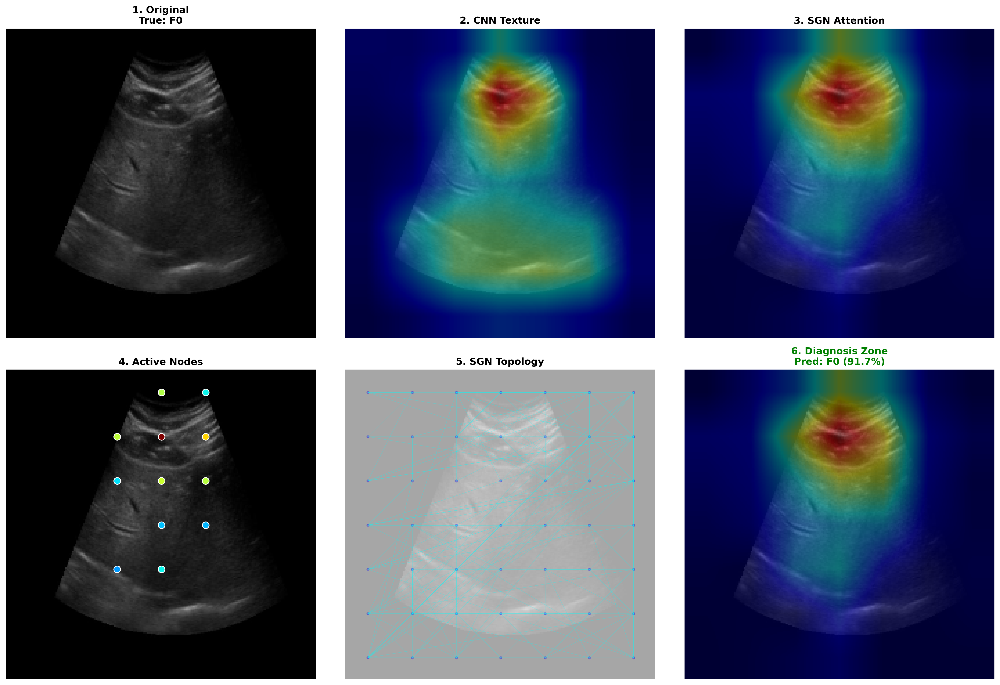


--- Class F1 (Image: P6873.jpg) ---


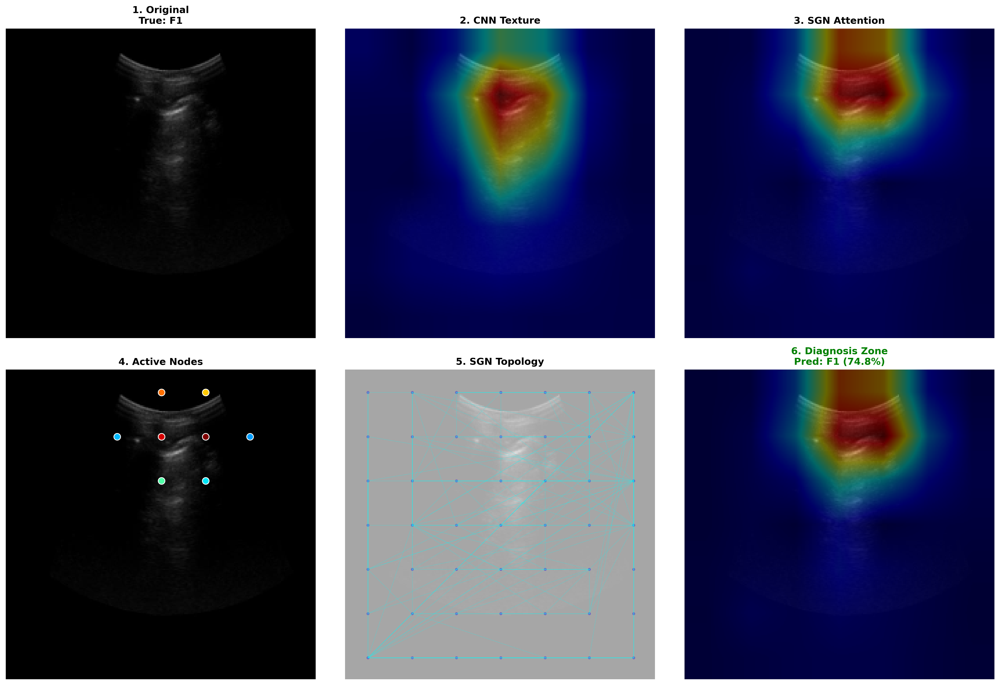


--- Class F2 (Image: m2523.jpg) ---


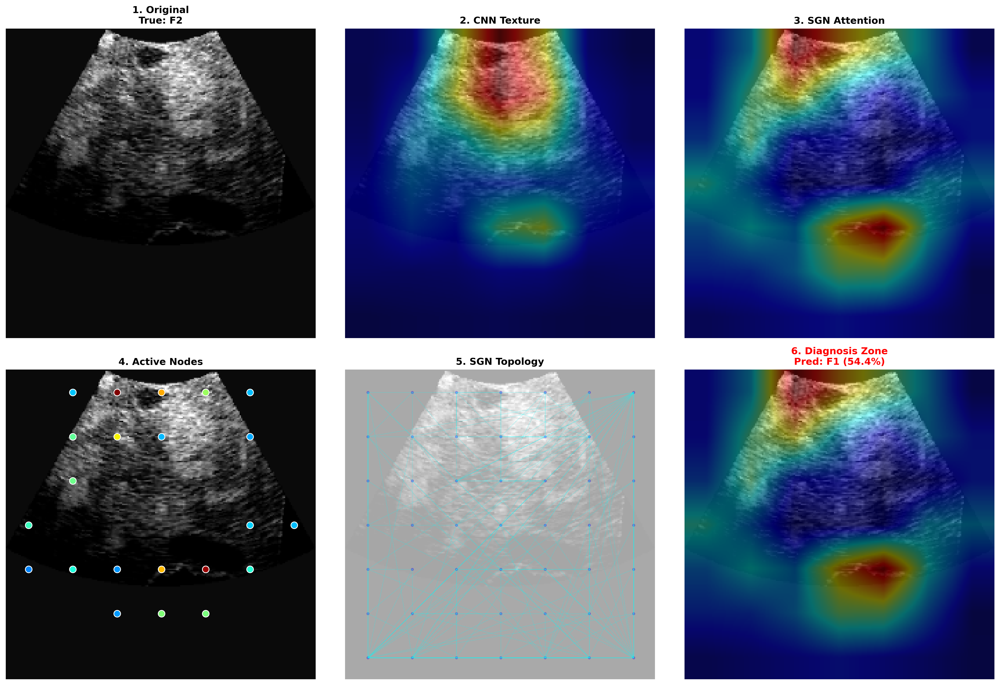


--- Class F3 (Image: ct11-66.png) ---


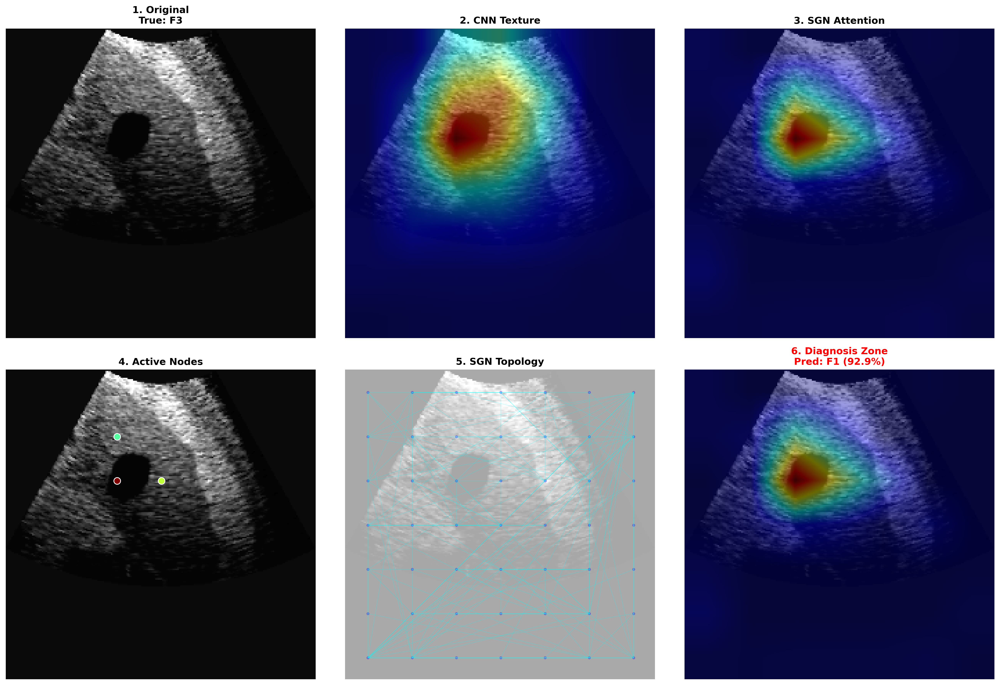


--- Class F4 (Image: p5060.jpg) ---


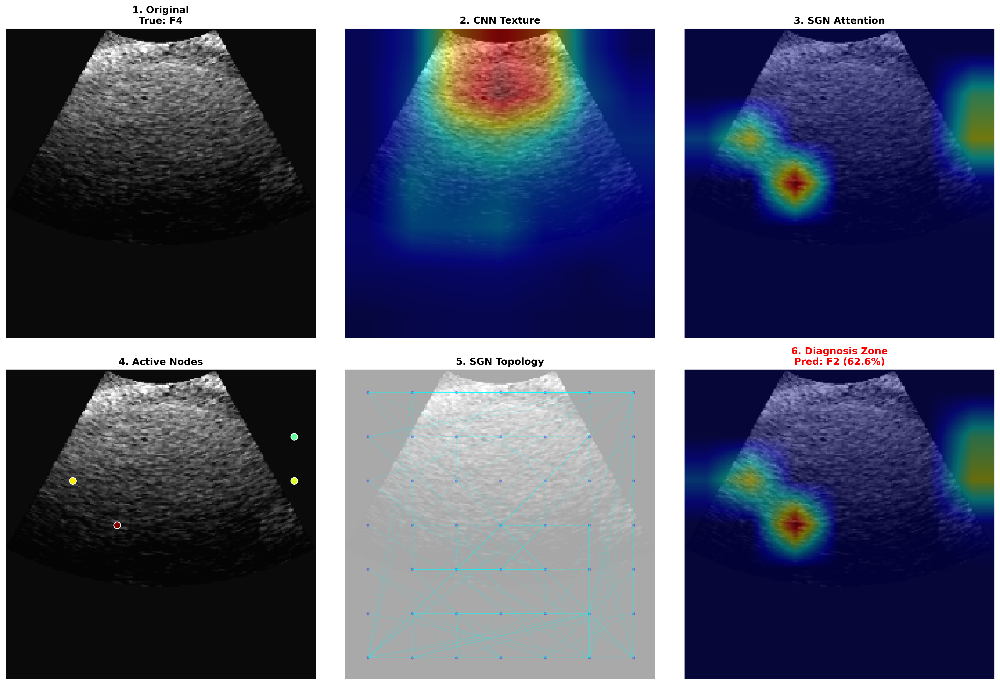

In [44]:
# --- CELL 13: 6-PANEL XAI VISUALIZATION (DenseNet + SGN) - RANDOM EVERY RUN ---
print("🚀 Generating 6-Panel XAI for DenseNet121 + SGN...")

import os
import cv2
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

# --------------------------------------------------
# 0) PICK A DF SAFELY
# --------------------------------------------------
def pick_df_for_xai():
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    if "test_df" in globals(): return test_df
    raise NameError("❌ No dataframe found.")

df_use = pick_df_for_xai()

# --------------------------------------------------
# 1) XAI EXTRACTION FUNCTION (SGN)
# --------------------------------------------------
def extract_sgn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, input, output):
        fmap = output[-1] if isinstance(output, (list, tuple)) else output
        fmaps.append(fmap)
        fmap.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "backbone"):
        raise AttributeError("❌ model.backbone not found.")

    h = model.backbone.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred = logits.argmax(1).item()
        conf = probs[0, pred].item()
        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    # Texture map
    fmap = fmaps[0].detach()
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = (tex - tex.min()) / (tex.max() - tex.min() + 1e-8)

    # Attention map
    grad = grads[0].detach()
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    # Graph topology (k-NN)
    with torch.no_grad():
        C, H, W = fmap.shape[1:]
        flat = fmap[0].view(C, -1).permute(1, 0)
        dist = torch.cdist(flat, flat)
        k = int(getattr(model, "k", 20))
        _, idx = dist.topk(k=k, largest=False)
        src = torch.arange(H * W, device=fmap.device).view(-1, 1).repeat(1, k).reshape(-1)
        dst = idx.reshape(-1)
        mask = src != dst
        edges = list(zip(src[mask].cpu().numpy(), dst[mask].cpu().numpy()))
        nodes = []
        for i in range(H * W):
            r, c = divmod(i, W)
            y = int((r + 0.5) * (CFG.IMG_SIZE / H))
            x = int((c + 0.5) * (CFG.IMG_SIZE / W))
            nodes.append((x, y))

    return tex, cam, nodes, edges, pred, conf

# --------------------------------------------------
# 2) HELPER: OVERLAY
# --------------------------------------------------
def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

# --------------------------------------------------
# 3) PLOTTING FUNCTION
# --------------------------------------------------
def plot_sgn_6_panel(img, tex, cam, nodes, edges, true_y, pred_y, conf, dpi=300):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)
    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    
    tex_rs = cv2.resize(tex, sz)
    cam_rs = cv2.resize(cam, sz)
    
    tex_overlay  = overlay_heatmap_on_image(img, tex_rs, 0.45, cv2.COLORMAP_JET)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs, 0.45, cv2.COLORMAP_JET)
    diag_overlay = overlay_heatmap_on_image(img, cam_rs, 0.40, cv2.COLORMAP_JET)
    
    font = {'weight': 'bold', 'size': 12}

    ax[0, 0].imshow(img)
    ax[0, 0].set_title(f"1. Original\nTrue: F{true_y}", font)

    ax[0, 1].imshow(tex_overlay)
    ax[0, 1].set_title("2. CNN Texture", font)

    ax[0, 2].imshow(cam_overlay)
    ax[0, 2].set_title("3. SGN Attention", font)

    ax[1, 0].imshow(img)
    flat = cam.flatten()
    for i, (nx, ny) in enumerate(nodes):
        if i < len(flat) and flat[i] > 0.25:
            ax[1, 0].scatter(nx, ny, c=[plt.cm.jet(flat[i])], s=70, edgecolors='w', zorder=2)
    ax[1, 0].set_title("4. Active Nodes", font)

    ax[1, 1].imshow(img, alpha=0.35)
    for i, (s, d) in enumerate(edges):
        if i % 2 == 0:
            x1, y1 = nodes[s]
            x2, y2 = nodes[d]
            ax[1, 1].plot([x1, x2], [y1, y2], c='cyan', alpha=0.25, lw=0.6)
    for nx, ny in nodes:
        ax[1, 1].scatter(nx, ny, c='blue', s=8, alpha=0.25)
    ax[1, 1].set_title("5. SGN Topology", font)

    ax[1, 2].imshow(diag_overlay)
    col = 'green' if true_y == pred_y else 'red'
    ax[1, 2].set_title(f"6. Diagnosis Zone\nPred: F{pred_y} ({conf*100:.1f}%)", font, color=col)

    for a in ax.flatten(): a.axis('off')
    plt.tight_layout()
    plt.show()

# --------------------------------------------------
# 4) RUN XAI EXAMPLES (RANDOM EVERY TIME)
# --------------------------------------------------
weights_path = "densenet_sgn_fold1_best.pth"
# Check Kaggle input if not in working directory
if not os.path.exists(weights_path):
    weights_path = "/kaggle/input/output-sgn-densnet/" + weights_path
    if not os.path.exists(weights_path):
        # Fallback to just the filename (maybe in current dir)
        weights_path = "densenet_sgn_fold1_best.pth"

if not os.path.exists(weights_path):
    print(f"⚠️ Weights not found at {weights_path}. Using random weights for DEMO.")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
else:
    print(f"✅ Loading weights: {weights_path}")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))

model.eval()

# FIX: Explicitly ensuring randomness by using a dynamic random_state
print("🎲 Picking fresh random samples...")

for c in range(CFG.NUM_CLASSES):
    subset = df_use[df_use.diagnosis == c] if "diagnosis" in df_use.columns else df_use[df_use["diagnosis"] == c]
    if len(subset) == 0:
        continue

    # Pick a random sample using a random integer seed
    row = subset.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]

    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))
    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    print(f"\n--- Class F{c} (Image: {os.path.basename(row.image_path)}) ---")
    tex, cam, nodes, edges, pred, conf = extract_sgn_xai(model, t, true_label=c)
    plot_sgn_6_panel(img, tex, cam, nodes, edges, true_y=c, pred_y=pred, conf=conf, dpi=300)

📊 Calculating Confusion Matrix...


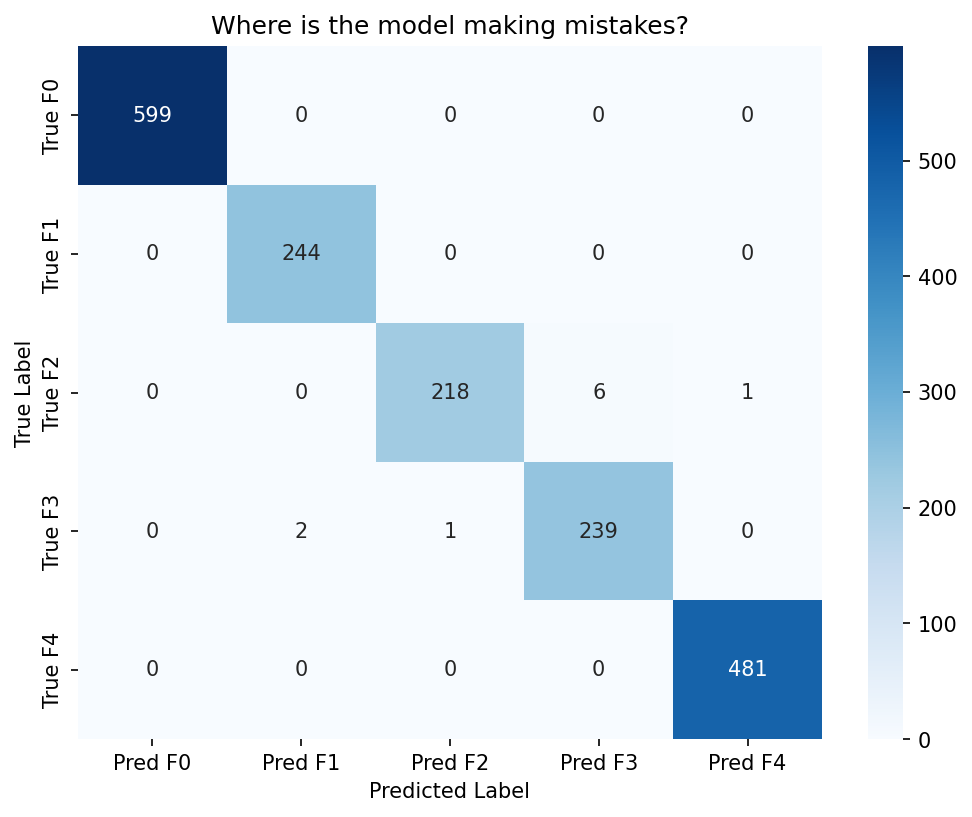

In [32]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# 1. Get predictions for the ENTIRE test set
model.eval()
all_preds = []
all_labels = []

print("📊 Calculating Confusion Matrix...")
with torch.no_grad():
    for images, labels in val_loader: # Use your validation or test loader
        images = images.to(CFG.DEVICE)
        outputs = model(images)
        preds = outputs.argmax(dim=1)
        
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.numpy())

# 2. Plot
cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(8, 6), dpi=150)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=[f"Pred F{i}" for i in range(CFG.NUM_CLASSES)],
            yticklabels=[f"True F{i}" for i in range(CFG.NUM_CLASSES)])
plt.title("Where is the model making mistakes?")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [49]:
# ==========================================
# 1. DEFINE & LOAD ENSEMBLE (SGN)
# ==========================================
import torch
import torch.nn.functional as F
import os

print("🚀 Loading SGN Ensemble Models...")

# Define wrapper to load a single fold
def load_sgn_model(path):
    if not os.path.exists(path):
        # Fallback for Kaggle paths
        if os.path.exists("/kaggle/working/" + path): path = "/kaggle/working/" + path
        elif os.path.exists("/kaggle/input/" + path): path = "/kaggle/input/" + path
        else:
            print(f"⚠️ Warning: Weights not found at {path}")
            return None
            
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    # strict=False allows loading even if some internal buffers mismatch slightly
    model.load_state_dict(torch.load(path, map_location=CFG.DEVICE), strict=False)
    model.eval()
    return model

# Load all 3 folds
models = []
for i in range(1, CFG.N_FOLDS + 1):
    path = f"densenet_sgn_fold{i}_best.pth"
    m = load_sgn_model(path)
    if m: models.append(m)

if not models:
    print("❌ ERROR: No models loaded. Using random model for debugging.")
    models.append(DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE))
else:
    print(f"✅ Loaded {len(models)} models successfully.")

# Ensemble Prediction Function
def predict_ensemble_sgn(img_tensor):
    avg_probs = None
    with torch.no_grad():
        for m in models:
            logits = m(img_tensor)
            probs = F.softmax(logits, dim=1)
            if avg_probs is None: avg_probs = probs
            else: avg_probs += probs
    return avg_probs / len(models)

🚀 Loading SGN Ensemble Models...
DenseNet feat channels: 1024
DenseNet feat channels: 1024
DenseNet feat channels: 1024
✅ Loaded 3 models successfully.



📊 Generating Interface Accuracy Grid...


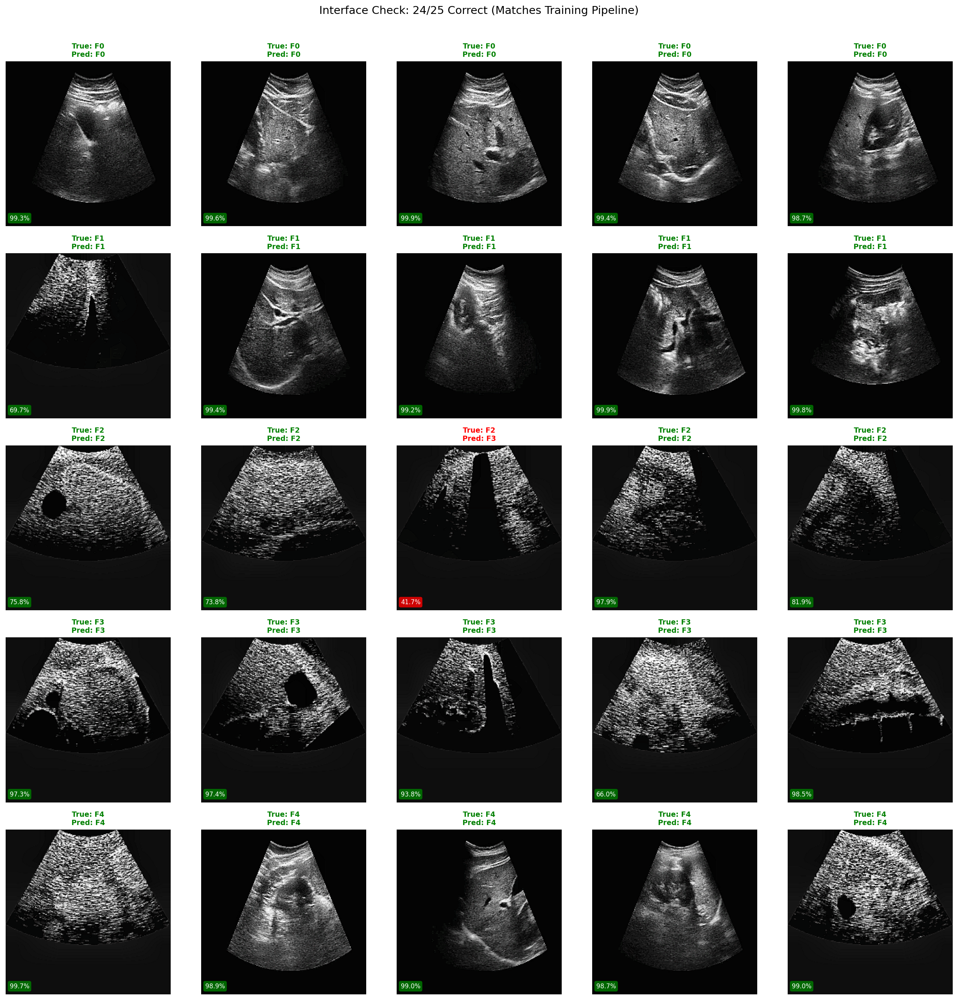

In [50]:
# ==========================================
# 2. ACCURACY CHECK INTERFACE (Grid of 5)
# ==========================================
import cv2
import numpy as np
import matplotlib.pyplot as plt

def check_accuracy_interface(df_data, per_class=5):
    print("\n📊 Generating Interface Accuracy Grid...")
    
    # Get class names
    class_names = list(class_map.keys()) if "class_map" in globals() else ["F0","F1","F2","F3","F4"]
    
    rows = []
    for c in range(CFG.NUM_CLASSES):
        sub = df_data[df_data["diagnosis"] == c]
        if len(sub) == 0: continue
        
        # Pick random samples
        take = min(per_class, len(sub))
        sub_sample = sub.sample(take).reset_index(drop=True)
        for i in range(take): rows.append(sub_sample.iloc[i])

    if not rows: return

    # Setup Grid
    cols = per_class
    rows_count = int(np.ceil(len(rows) / cols))
    fig, axes = plt.subplots(rows_count, cols, figsize=(3.5*cols, 3.5*rows_count), dpi=150)
    
    # Handle single row/col cases
    if rows_count == 1: axes = axes.reshape(1, -1)
    elif cols == 1: axes = axes.reshape(-1, 1)
    
    axes_flat = axes.flatten()
    correct_count = 0
    
    for idx, ax in enumerate(axes_flat):
        ax.axis("off")
        if idx >= len(rows): continue
        
        row = rows[idx]
        
        # --- STEP 1: CV2 PREPROCESSING (Blur/CLAHE/Sharpen) ---
        # This function MUST be defined in your notebook (from Cell 4)
        img_processed = preprocess_for_model(row.image_path)
        
        if img_processed is None:
            ax.set_title("Load Fail")
            continue
            
        # --- STEP 2: ALBUMENTATIONS (Resize/Normalize) ---
        aug = valid_tfms(image=img_processed)
        t = aug["image"].unsqueeze(0).to(CFG.DEVICE)
        
        # --- STEP 3: PREDICT ---
        probs = predict_ensemble_sgn(t)[0]
        pred = torch.argmax(probs).item()
        conf = probs[pred].item() * 100
        
        true_y = int(row.diagnosis)
        is_correct = (pred == true_y)
        if is_correct: correct_count += 1
        
        # Display
        col = "green" if is_correct else "red"
        # Resize for display only
        img_vis = cv2.resize(img_processed, (224, 224))
        ax.imshow(img_vis)
        
        title = f"True: {class_names[true_y]}\nPred: {class_names[pred]}"
        ax.set_title(title, color=col, fontweight="bold", fontsize=9)
        
        # Add confidence badge
        ax.text(5, 215, f"{conf:.1f}%", color="white", fontsize=8, 
                bbox=dict(facecolor=col, alpha=0.8, edgecolor='none', boxstyle='round'))

    plt.suptitle(f"Interface Check: {correct_count}/{len(rows)} Correct (Matches Training Pipeline)", fontsize=14, y=1.01)
    plt.tight_layout()
    plt.show()

# Run it on test data
if "test_df" in globals(): check_accuracy_interface(test_df)
elif "train_val_df" in globals(): check_accuracy_interface(train_val_df)

🚀 Generating 6-Panel XAI for DenseNet121 + SGN...
✅ Loading weights: densenet_sgn_fold1_best.pth
DenseNet feat channels: 1024
🎲 Picking fresh random samples...

--- Class F0 (Image: a7811.jpg) ---


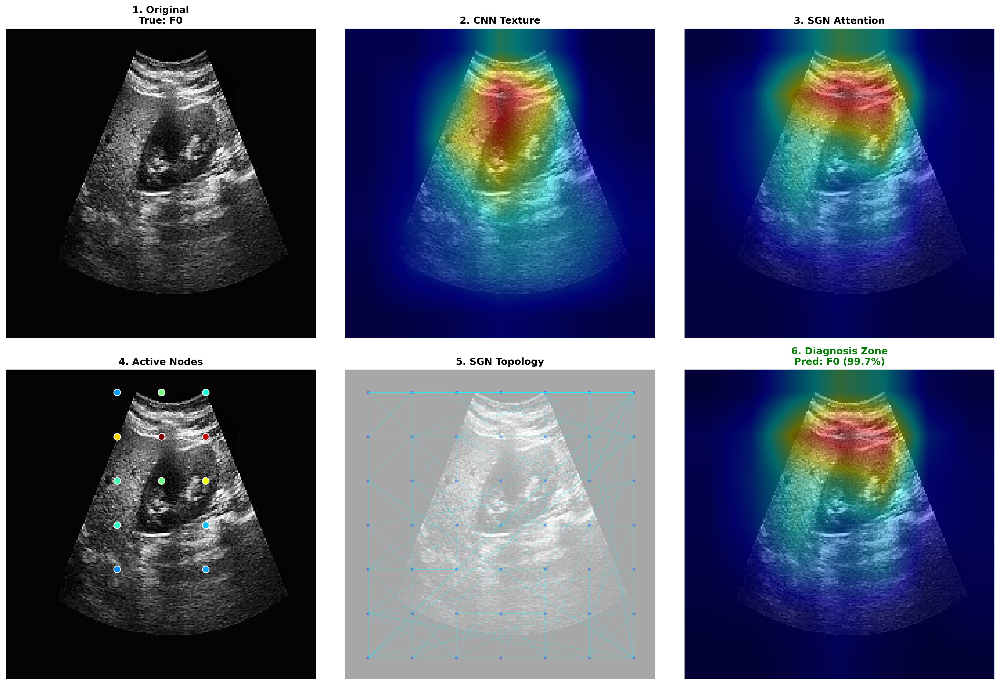


--- Class F1 (Image: O8052.jpg) ---


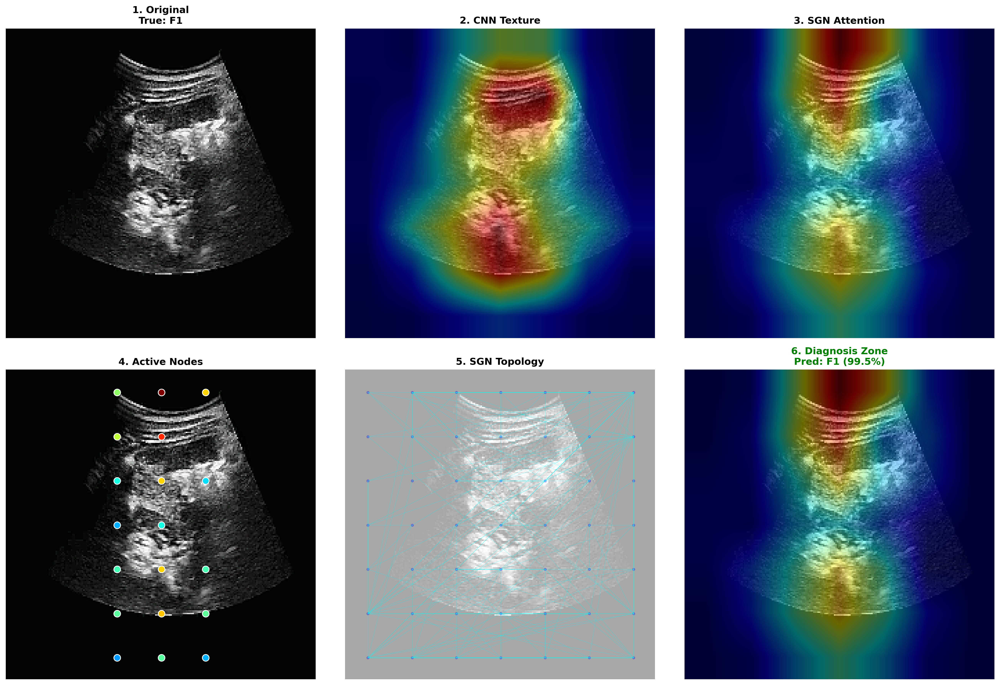


--- Class F2 (Image: N216.jpg) ---


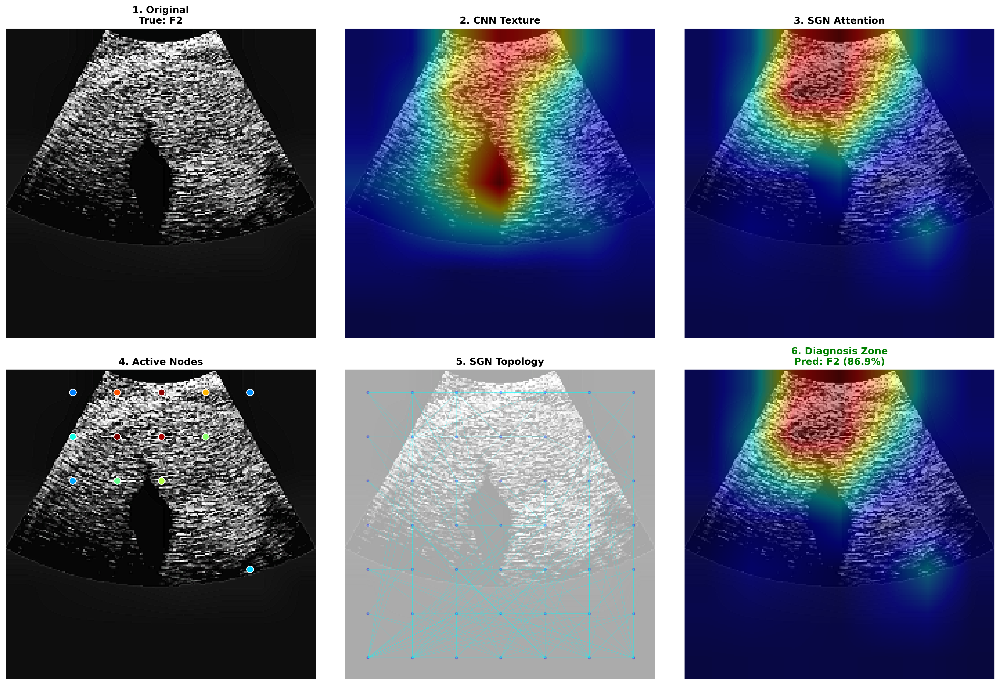


--- Class F3 (Image: ct8-47.png) ---


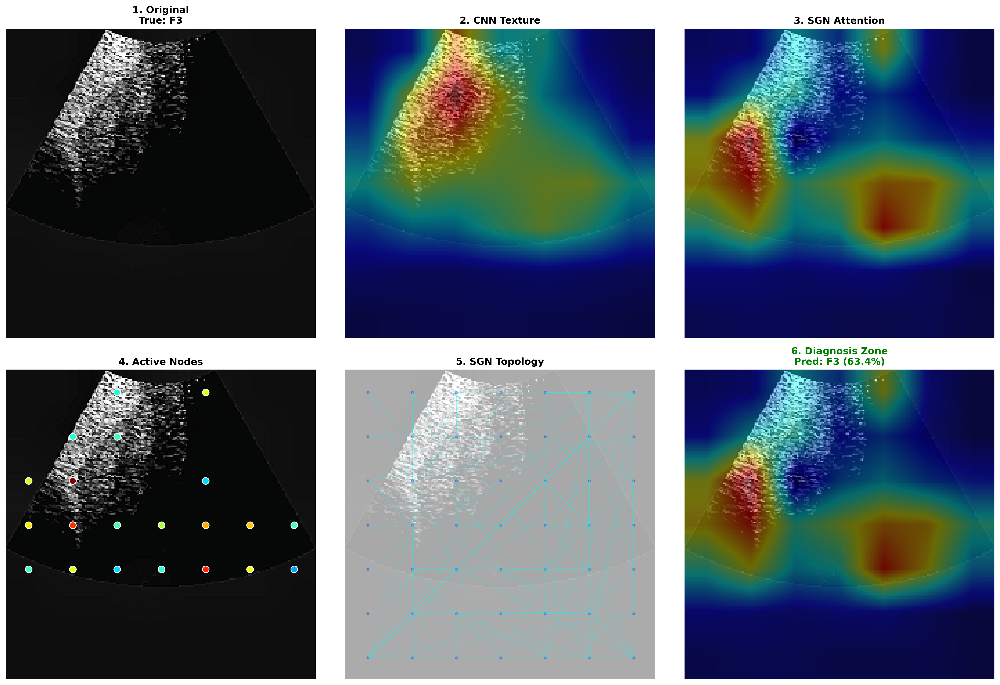


--- Class F4 (Image: L2892.jpg) ---


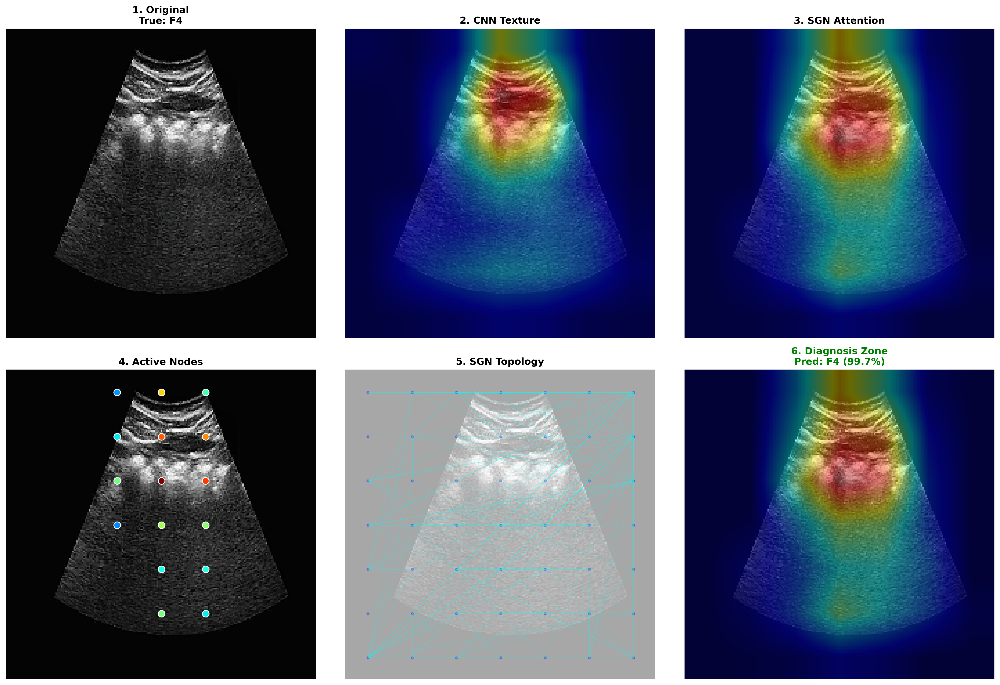

In [60]:
# --- CELL 13: 6-PANEL XAI VISUALIZATION (DenseNet + SGN) - FIXED & ACCURATE ---
print("🚀 Generating 6-Panel XAI for DenseNet121 + SGN...")

import os
import cv2
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

# --------------------------------------------------
# 0) PICK A DF SAFELY
# --------------------------------------------------
def pick_df_for_xai():
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    if "test_df" in globals(): return test_df
    raise NameError("❌ No dataframe found.")

df_use = pick_df_for_xai()

# --------------------------------------------------
# 1) XAI EXTRACTION FUNCTION (SGN) - FIXED HOOK
# --------------------------------------------------
def extract_sgn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    # 🔥 FIX: Handle list output from backbone safely
    def hook(module, input, output):
        # If output is a list (features_only=True), take the last element
        if isinstance(output, (list, tuple)):
            fmap = output[-1]
        else:
            fmap = output
            
        fmaps.append(fmap)
        fmap.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "backbone"):
        raise AttributeError("❌ model.backbone not found.")

    h = model.backbone.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred = logits.argmax(1).item()
        conf = probs[0, pred].item()
        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if not fmaps or not grads:
        # Fallback if hook didn't capture
        return None, None, [], [], pred, conf

    # Texture map
    fmap = fmaps[0].detach()
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = (tex - tex.min()) / (tex.max() - tex.min() + 1e-8)

    # Attention map
    grad = grads[0].detach()
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    # Graph topology (k-NN)
    with torch.no_grad():
        C, H, W = fmap.shape[1:]
        flat = fmap[0].view(C, -1).permute(1, 0)
        dist = torch.cdist(flat, flat)
        k = int(getattr(model, "k", 20))
        _, idx = dist.topk(k=k, largest=False)
        src = torch.arange(H * W, device=fmap.device).view(-1, 1).repeat(1, k).reshape(-1)
        dst = idx.reshape(-1)
        mask = src != dst
        edges = list(zip(src[mask].cpu().numpy(), dst[mask].cpu().numpy()))
        nodes = []
        for i in range(H * W):
            r, c = divmod(i, W)
            y = int((r + 0.5) * (CFG.IMG_SIZE / H))
            x = int((c + 0.5) * (CFG.IMG_SIZE / W))
            nodes.append((x, y))

    return tex, cam, nodes, edges, pred, conf

# --------------------------------------------------
# 2) HELPER: OVERLAY
# --------------------------------------------------
def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

# --------------------------------------------------
# 3) PLOTTING FUNCTION
# --------------------------------------------------
def plot_sgn_6_panel(img, tex, cam, nodes, edges, true_y, pred_y, conf, dpi=300):
    if tex is None: 
        print("❌ Error: XAI extraction failed.")
        return

    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)
    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    
    tex_rs = cv2.resize(tex, sz)
    cam_rs = cv2.resize(cam, sz)
    
    tex_overlay  = overlay_heatmap_on_image(img, tex_rs, 0.45, cv2.COLORMAP_JET)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs, 0.45, cv2.COLORMAP_JET)
    diag_overlay = overlay_heatmap_on_image(img, cam_rs, 0.40, cv2.COLORMAP_JET)
    
    font = {'weight': 'bold', 'size': 12}

    ax[0, 0].imshow(img)
    ax[0, 0].set_title(f"1. Original\nTrue: F{true_y}", font)

    ax[0, 1].imshow(tex_overlay)
    ax[0, 1].set_title("2. CNN Texture", font)

    ax[0, 2].imshow(cam_overlay)
    ax[0, 2].set_title("3. SGN Attention", font)

    ax[1, 0].imshow(img)
    flat = cam.flatten()
    for i, (nx, ny) in enumerate(nodes):
        if i < len(flat) and flat[i] > 0.25:
            ax[1, 0].scatter(nx, ny, c=[plt.cm.jet(flat[i])], s=70, edgecolors='w', zorder=2)
    ax[1, 0].set_title("4. Active Nodes", font)

    ax[1, 1].imshow(img, alpha=0.35)
    for i, (s, d) in enumerate(edges):
        if i % 2 == 0:
            x1, y1 = nodes[s]
            x2, y2 = nodes[d]
            ax[1, 1].plot([x1, x2], [y1, y2], c='cyan', alpha=0.25, lw=0.6)
    for nx, ny in nodes:
        ax[1, 1].scatter(nx, ny, c='blue', s=8, alpha=0.25)
    ax[1, 1].set_title("5. SGN Topology", font)

    ax[1, 2].imshow(diag_overlay)
    col = 'green' if true_y == pred_y else 'red'
    ax[1, 2].set_title(f"6. Diagnosis Zone\nPred: F{pred_y} ({conf*100:.1f}%)", font, color=col)

    for a in ax.flatten(): a.axis('off')
    plt.tight_layout()
    plt.show()

# --------------------------------------------------
# 4) RUN XAI EXAMPLES (CORRECT PREPROCESSING)
# --------------------------------------------------
weights_path = "densenet_sgn_fold1_best.pth"
if not os.path.exists(weights_path):
    weights_path = "/kaggle/input/output-sgn-densnet/" + weights_path
    if not os.path.exists(weights_path):
        weights_path = "densenet_sgn_fold1_best.pth"

if not os.path.exists(weights_path):
    print(f"⚠️ Weights not found at {weights_path}. Using random weights.")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
else:
    print(f"✅ Loading weights: {weights_path}")
    model = DenseNet_kNNSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))

model.eval()

print("🎲 Picking fresh random samples...")

# Ensure valid_tfms exists
if "valid_tfms" not in globals():
    import albumentations as A; from albumentations.pytorch import ToTensorV2
    valid_tfms = A.Compose([A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE), A.Normalize(), ToTensorV2()])

for c in range(CFG.NUM_CLASSES):
    subset = df_use[df_use.diagnosis == c] if "diagnosis" in df_use.columns else df_use[df_use["diagnosis"] == c]
    if len(subset) == 0:
        continue

    # Pick a random sample using a random integer seed
    row = subset.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]

    # 🔥 FIX: Apply the EXACT preprocessing pipeline used in training
    if "preprocess_for_model" in globals():
        img_processed = preprocess_for_model(row.image_path)
    else:
        # Fallback if undefined (but try to define it in cell 4!)
        img_raw = cv2.imread(row.image_path)
        img_rgb = cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB)
        img_processed = cv2.medianBlur(img_rgb, 3) # Mimic basic steps

    if img_processed is None: continue

    # Resize for visualization (224x224)
    img_vis = cv2.resize(img_processed, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    # Transform for model (Normalize -> Tensor)
    t = valid_tfms(image=img_vis)["image"].unsqueeze(0).to(CFG.DEVICE)

    print(f"\n--- Class F{c} (Image: {os.path.basename(row.image_path)}) ---")
    tex, cam, nodes, edges, pred, conf = extract_sgn_xai(model, t, true_label=c)
    plot_sgn_6_panel(img_vis, tex, cam, nodes, edges, true_y=c, pred_y=pred, conf=conf, dpi=300)